<a href="https://colab.research.google.com/github/mahin-arvind/Appliance-Energy-Prediction/blob/main/Copy_of_NETFLIX_MOVIES_AND_TV_SHOWS_CLUSTERING.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Problem Statement**

This dataset consists of tv shows and movies available on Netflix as of 2019. The dataset is collected from Flixable which is a third-party Netflix search engine.

In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

Integrating this dataset with other external datasets such as IMDB ratings, rotten tomatoes can also provide many interesting findings.

## <b>In this  project, you are required to do </b>
1. Exploratory Data Analysis 
2. Understanding what type content is available in different countries
3. Has Netflix increasingly focused on TV as compared to movies in recent years?
4. Clustering similar content by matching text-based features



#**FUNCTION REFERENCES**

In [300]:
# ALL FUNCTIONS

import nltk
nltk.download('stopwords')
stopwords = set(nltk.corpus.stopwords.words('english'))

#Tokenization
import regex as re
def tokenize(text):
  return re.findall(r'[\w-]*\p{L}[\w-]*', text)


#Function to Remove Stop Words

def remove_stop(tokens):
  return ''.join([t for t in tokens if t.lower() not in stopwords])
#Text Processing Pipeline
'''
used with df.applymap or df.apply
Example : df['tokens'] = df['text'].apply(prepare, pipeline=pipeline)
'''
pipeline = [str.lower, tokenize, remove_stop]
def prepare(text, pipeline):
  tokens = text
  for transform in pipeline:
    tokens = transform(tokens)
  return tokens



from collections import Counter
'''
The function takes, as a first parameter, a Pandas DataFrame and takes the column
name containing the tokens or the text as a second parameter. As we already stored
the prepared tokens in the column tokens of the DataFrame containing the speeches,
we can use the following two lines of code to compute the DataFrame with word frequencies
and display the top five tokens
  code : freq_df = count
'''

def count_words(df, column='description', preprocess=None, min_freq=2):
# process tokens and update counter
  def update(doc):
    tokens = doc if preprocess is None else preprocess(doc)
    counter.update(tokens)
  # create counter and run through all data
  counter = Counter()
  df[column].map(update)

  # transform counter into a DataFrame
  freq_df = pd.DataFrame.from_dict(counter, orient='index', columns=['freq'])
  freq_df = freq_df.query('freq >= @min_freq')
  freq_df.index.name = 'token'
  return freq_df.sort_values('freq', ascending=False)

#Wordcloud Generator
from wordcloud import WordCloud
def wordcloud(word_freq, title=None, max_words=200, stopwords=None):
  wc = WordCloud(width=800, height=400,
  background_color= "black", colormap="Paired",
  max_font_size=150, max_words=max_words)
  # convert DataFrame into dict
  if type(word_freq) == pd.Series:
    counter = Counter(word_freq.fillna(0).to_dict())
  else:
    counter = word_freq
  # filter stop words in frequency counter
  if stopwords is not None:
    counter = {token:freq for (token, freq) in counter.items()if token not in stopwords}
  wc.generate_from_frequencies(counter)
  plt.title(title)
  plt.imshow(wc, interpolation='bilinear')
  plt.axis("off")

#Inverse Document Frequency Calculator
def compute_idf(df, column='description', preprocess=None, min_df=2):
  def update(doc):
    tokens = doc if preprocess is None else preprocess(doc)
    counter.update(set(tokens))
  # count tokens
  counter = Counter()
  df[column].map(update)
  # create DataFrame and compute idf
  idf_df = pd.DataFrame.from_dict(counter, orient='index', columns=['df'])
  idf_df = idf_df.query('df >= @min_df')
  idf_df['idf'] = np.log(len(df)/idf_df['df'])+0.1
  idf_df.index.name = 'token'
  return idf_df

#Analyzing N-Grams
def ngrams(tokens, n=2, sep=' ', stopwords=set()):
  return [sep.join(ngram) for ngram in zip(*[tokens[i:]for i in range(n)])
    if len([t for t in ngram if t in stopwords])==0]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# **Attribute Information**

1. show_id : Unique ID for every Movie / Tv Show

2. type : Identifier - A Movie or TV Show

3. title : Title of the Movie / Tv Show

4. director : Director of the Movie

5. cast : Actors involved in the movie / show

6. country : Country where the movie / show was produced

7. date_added : Date it was added on Netflix

8. release_year : Actual Releaseyear of the movie / show

9. rating : TV Rating of the movie / show

10. duration : Total Duration - in minutes or number of seasons

11. listed_in : Genere

12. description: The Summary description

In [301]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import seaborn as sns

from sklearn.feature_extraction.text import CountVectorizer
from textblob import TextBlob
import scipy.stats as stats

from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE


%matplotlib inline

In [302]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [303]:
path = '/content/drive/MyDrive/Datasets/Unsupervised/Clustering/NETFLIX MOVIES AND TV SHOWS CLUSTERING/NETFLIX MOVIES AND TV SHOWS CLUSTERING.csv'
df = pd.read_csv(path)

INFORMATION: COLUMN NAMES, MISSING VALUES AND DATA TYPES

In [304]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


COLUMNS


In [305]:
df.columns

Index(['show_id', 'type', 'title', 'director', 'cast', 'country', 'date_added',
       'release_year', 'rating', 'duration', 'listed_in', 'description'],
      dtype='object')

DATASET SUMMARY

In [306]:
df.describe(include = 'O').T

,count,unique,top,freq
show_id,7787,7787,s1,1
type,7787,2,Movie,5377
title,7787,7787,3%,1
director,5398,4049,"Raúl Campos, Jan Suter",18
cast,7069,6831,David Attenborough,18
country,7280,681,United States,2555
date_added,7777,1565,"January 1, 2020",118
rating,7780,14,TV-MA,2863
duration,7787,216,1 Season,1608
listed_in,7787,492,Documentaries,334


In [307]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
release_year,7787.0,2013.93258,8.757395,1925.0,2013.0,2017.0,2018.0,2021.0


MISSING VALUES

In [308]:
df.isna().sum()

show_id            0
type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

In [309]:
#HANDLING MISSING VALUES
df['director'].fillna('unknown', inplace=True)
df['cast'].fillna('unknown', inplace=True)
df['country'].fillna('unknown', inplace=True)
df['date_added'].fillna('unknown', inplace=True)
df['rating'].fillna('unknown', inplace=True)

CONVERTING 'date_added' to datetime format

In [310]:
import datetime as dt

In [311]:
def date(row):
  a = row['date_added']
  if 'unknown' not in a:
    month = a.split()[0]
    year = a.split()[-1]
    day = a.split()[1].split(',')[0]
    a = dt.datetime.strptime(f'{month[:3]} {day} {year}' , '%b %d %Y')
    return a
  else:
    return np.nan

df['date_added'] = df.apply(lambda x: date(x), axis=1)


##FEATURE ENGINEERING LISTED_IN

Genres are extracted and re-defined accordingly

In [312]:
a = df.copy()

In [313]:

a['listed_in'] = a.listed_in.apply(lambda row: row.split(', '))
a.explode('listed_in')['listed_in'].unique()

array(['International TV Shows', 'TV Dramas', 'TV Sci-Fi & Fantasy',
       'Dramas', 'International Movies', 'Horror Movies',
       'Action & Adventure', 'Independent Movies', 'Sci-Fi & Fantasy',
       'TV Mysteries', 'Thrillers', 'Crime TV Shows', 'Docuseries',
       'Documentaries', 'Sports Movies', 'Comedies', 'Anime Series',
       'Reality TV', 'TV Comedies', 'Romantic Movies',
       'Romantic TV Shows', 'Science & Nature TV', 'Movies',
       'British TV Shows', 'Korean TV Shows', 'Music & Musicals',
       'LGBTQ Movies', 'Faith & Spirituality', "Kids' TV",
       'TV Action & Adventure', 'Spanish-Language TV Shows',
       'Children & Family Movies', 'TV Shows', 'Classic Movies',
       'Cult Movies', 'TV Horror', 'Stand-Up Comedy & Talk Shows',
       'Teen TV Shows', 'Stand-Up Comedy', 'Anime Features',
       'TV Thrillers', 'Classic & Cult TV'], dtype=object)

In [314]:
replacing_genre = {'International TV Shows': '-',
                   'TV Dramas': 'Drama',
                   'TV Sci-Fi & Fantasy': 'SciFiFantasy',
                   'Dramas': 'Drama' ,
                   'International Movies': '-',
                   'Horror Movies': 'Horror',
                   'Action & Adventure': 'ActionAdventure',
                   'Independent Movies': '-',
                   'Sci-Fi & Fantasy': 'SciFiFantasy',
                  'TV Mysteries': 'Mystery'       ,
                  'Thrillers': 'Thriller',
                   'Crime TV Shows': 'Crime',
                   'Docuseries': 'Documentary',
                  'Documentaries': 'Documentary', 'Sports Movies': 'Sports',
                   'Comedies':'Comedy',
                   'Anime Series': 'Anime',
                  'Reality TV': 'Reality',
                   'TV Comedies': 'Comedy',
                   'Romantic Movies': 'Romance',
                  'Romantic TV Shows': 'Romance', 
                   'Science & Nature TV': 'Science',
                   'Movies': '-',
                  'British TV Shows': '-',
                   'Korean TV Shows': '-',
                   'Music & Musicals': 'Music',
                  'LGBTQ Movies': 'LGBTQ',
                   'Faith & Spirituality': 'Spirituality', 
                   "Kids' TV": 'Kids',
                  'TV Action & Adventure': 'ActionAdventure',
                   'Spanish-Language TV Shows': '-',
                  'Children & Family Movies': 'Family', 
                   'TV Shows': '-',
                   'Classic Movies': 'Classic',
                  'Cult Movies': 'Cult',
                   'TV Horror': 'Horror',
                   'Stand-Up Comedy & Talk Shows':'Comedy, TalkShow',
                  'Teen TV Shows': 'Teen', 'Stand-Up Comedy':'Comedy', 
                   'Anime Features':'Anime',
                  'TV Thrillers': 'Thriller',
                   'Classic & Cult TV':'Classic, Cult'}

In [315]:
def genre_replace(row, replacing_genre = replacing_genre):
  new_text = []
 
  for word in (row['listed_in']):
    if word in replacing_genre:
      if '-' not in replacing_genre[word]:
       new_text.append(replacing_genre[word])
    else:
      print(word, 'not present in dictionary')

  return(', '.join(new_text))
  

df['Genres'] = a.apply(lambda row: genre_replace(row),axis=1)
df['Genres'] = df['Genres'].apply(lambda row: row.split(', '))

In [316]:
(df.explode('Genres')['Genres'].unique())

array(['Drama', 'SciFiFantasy', 'Horror', 'ActionAdventure', 'Mystery',
       'Thriller', 'Crime', 'Documentary', 'Sports', 'Comedy', 'Anime',
       'Reality', 'Romance', 'Science', '', 'Music', 'LGBTQ',
       'Spirituality', 'Kids', 'Family', 'Classic', 'Cult', 'TalkShow',
       'Teen'], dtype=object)

#**#1 EXPLORATORY DATA ANALYSIS**

### **Histogram plot of release dates of shows/movies on Netflix**

<Figure size 1008x576 with 0 Axes>

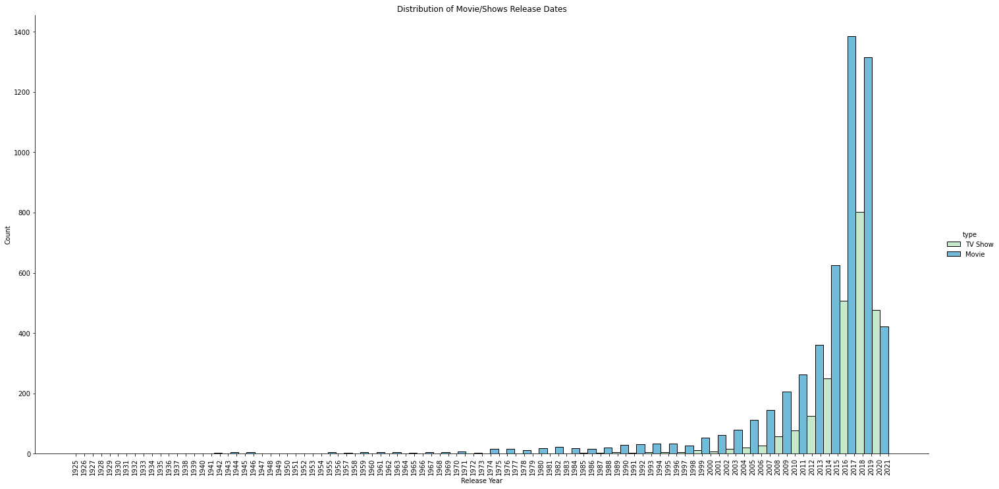

In [317]:
a = plt.figure(figsize=(14,8))
a = sns.displot(x='release_year', hue = 'type', data = df, kind = 'hist', height=10, aspect=2, bins = 50, multiple='dodge', palette='GnBu')
a = plt.xticks(ticks= np.arange(df.release_year.min(),df.release_year.max()+1,1), rotation = 90)
a = plt.title('Distribution of Movie/Shows Release Dates')
a = plt.xlabel('Release Year')

####**OBSERVATIONS**
> * **Most Movies streaming on the platform were released after 2010**
> * **Most  TV Shows streaming on the platform were released after 2015**
> * **The year 2017 had highest number of Movie and TV show releases on the platform**

In [318]:
df['date_added'].dt.year.max()

2021.0

### **Histogram plot of dates of number of shows/movies added by the Streaming giant**

<Figure size 1008x576 with 0 Axes>

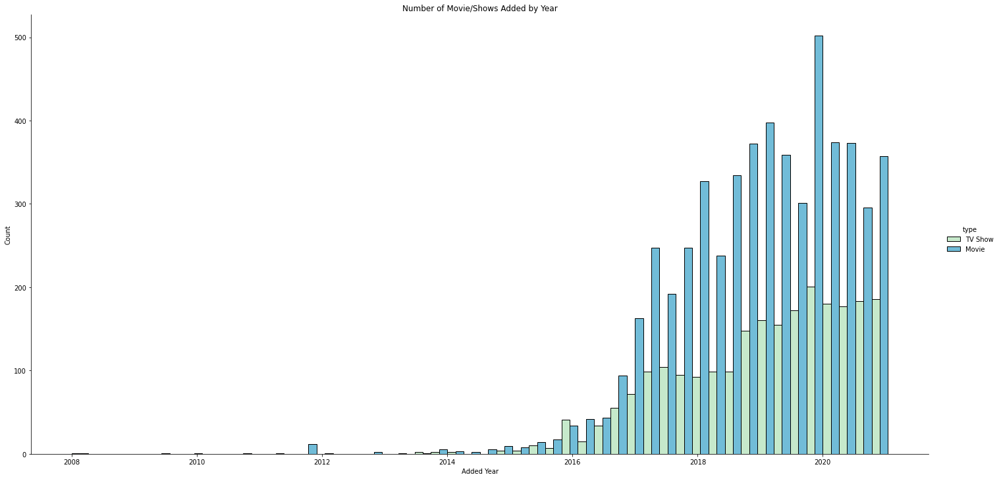

In [319]:
a = plt.figure(figsize=(14,8))
a = sns.displot(x= df['date_added'], hue = 'type', data = df, kind = 'hist', height=10, aspect=2, bins = 50, multiple='dodge', palette='GnBu')
a = plt.title('Number of Movie/Shows Added by Year')
a = plt.xlabel('Added Year')

####**OBSERVATIONS**
> * **Netflix began adding videos to the platform from 2008**
> * **The streaming giant started aggressively adding movies and TV shows from 2017**
> * **More movies are added as compared to TV shows**

### **Type of Videos on Netflix**

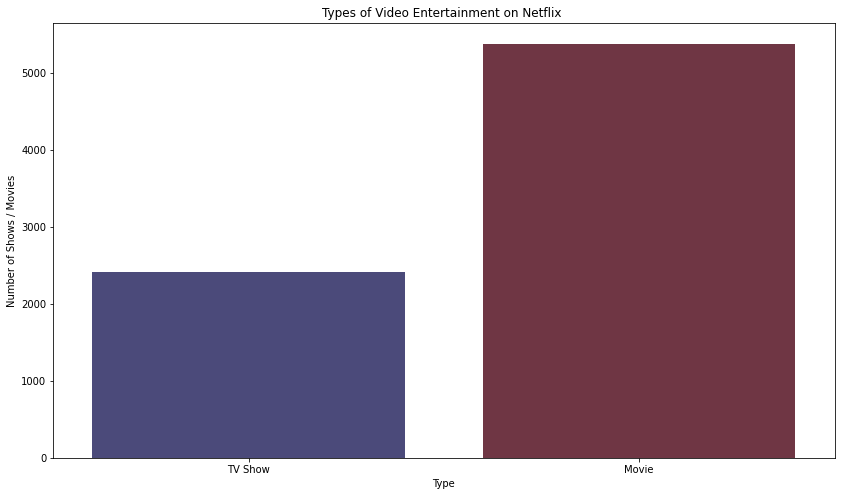

In [320]:
a = plt.figure(figsize=(14,8))
a = sns.countplot(x= df['type'], data = df,palette='icefire')
a = plt.title('Types of Video Entertainment on Netflix ')
a = plt.xlabel('Type')
a = plt.ylabel('Number of Shows / Movies')

####**OBSERVATIONS**
> * **There are almost twice as many movies as TV shows on Netflix.**

### **Different Ratings on the Platform**

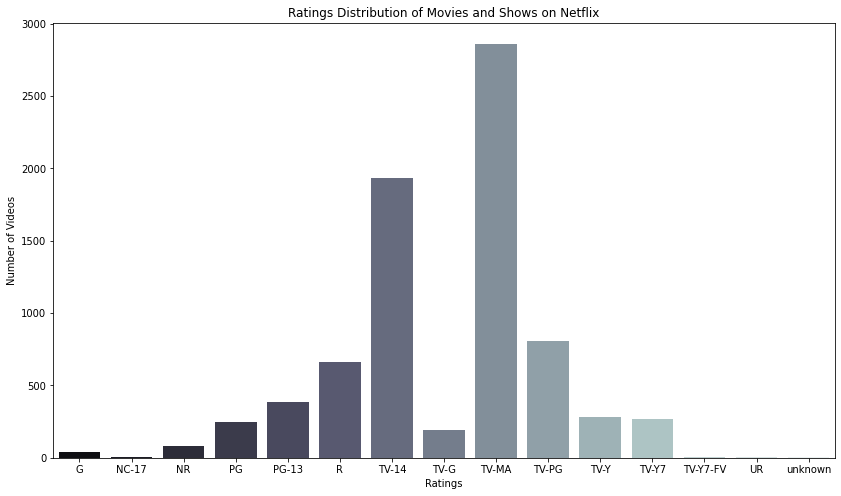

In [321]:
a = plt.figure(figsize=(14,8))
d = df.groupby('rating').agg({'show_id':'count'}).reset_index()
a = sns.barplot(x= d['rating'], y=d['show_id'], palette='bone')
a = plt.title('Ratings Distribution of Movies and Shows on Netflix')
a = plt.xlabel('Ratings')
a = plt.ylabel('Number of Videos')

####**OBSERVATIONS**
> * **Most content on Netflix is rated for Mature Audiences and over 14 years old**

### **Top 10 Countries that produced content on Netflix**

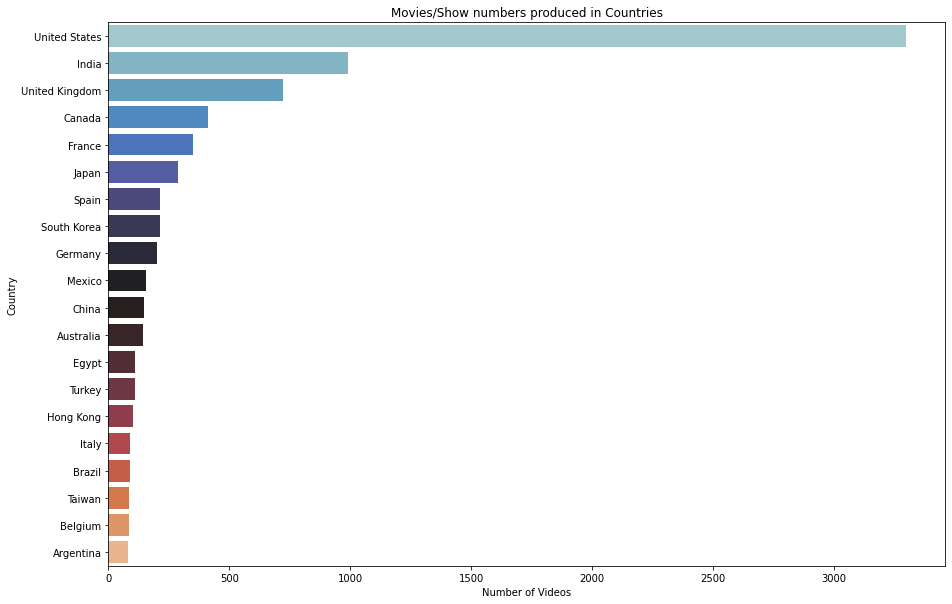

In [322]:
a = df[df.country != 'unknown'].loc[:,['show_id','title','country', 'listed_in']].copy()
countrylist = (a['country'].to_list())

newlist = []
for country in countrylist:
  if ',' in country:
    a = country.split(', ')
    newlist = newlist + a
  else:
    newlist.append(country)

country_list = pd.DataFrame({'country' : newlist, 'id':np.arange(0,len(newlist),1)})
a = country_list.groupby('country').agg({'id':'count'}).sort_values('id', ascending= False).head(20).reset_index()
plt.figure(figsize=(15,10))
a = sns.barplot(y = 'country', x = 'id',data = a , palette='icefire')
a = plt.title('Movies/Show numbers produced in Countries')
a = plt.ylabel('Country')
a = plt.xlabel('Number of Videos')
top10countries = country_list.groupby('country').agg({'id':'count'}).sort_values('id', ascending= False).head(10).reset_index()['country'].unique()

####**OBSERVATIONS**
---
> **Top Countries in Netflix are:**
1. **United States**
2.**India**
3.**United Kingdom**
4.**Canada**
5.**France**

---



### **Top Genres on Netflix**

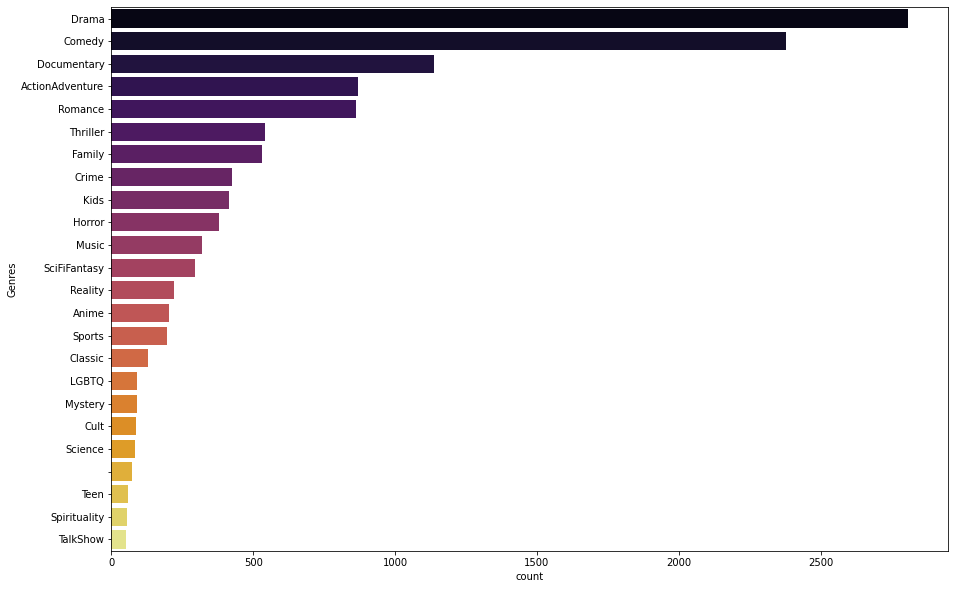

In [323]:
a = df.loc[:,['show_id','title','country', 'Genres']].copy()
a = a.explode('Genres')
genre_list = a.Genres.unique()
group = a.groupby('Genres').agg(count = ('show_id','count')).sort_values('count', ascending= False).reset_index()
plt.figure(figsize=(15,10))
_ = sns.barplot(y = 'Genres', x = 'count',data = group , palette='inferno')


In [324]:
top15genres = group.head(15)['Genres'].to_list()

####**OBSERVATIONS**
---
> **Top Genres in Netflix are:**
1. **Drama**
2.**Comedy**
3.**Documentary**
4.**Action and Adventure**
5.**Romance**

---



### **Frequent Directors on Netflix**

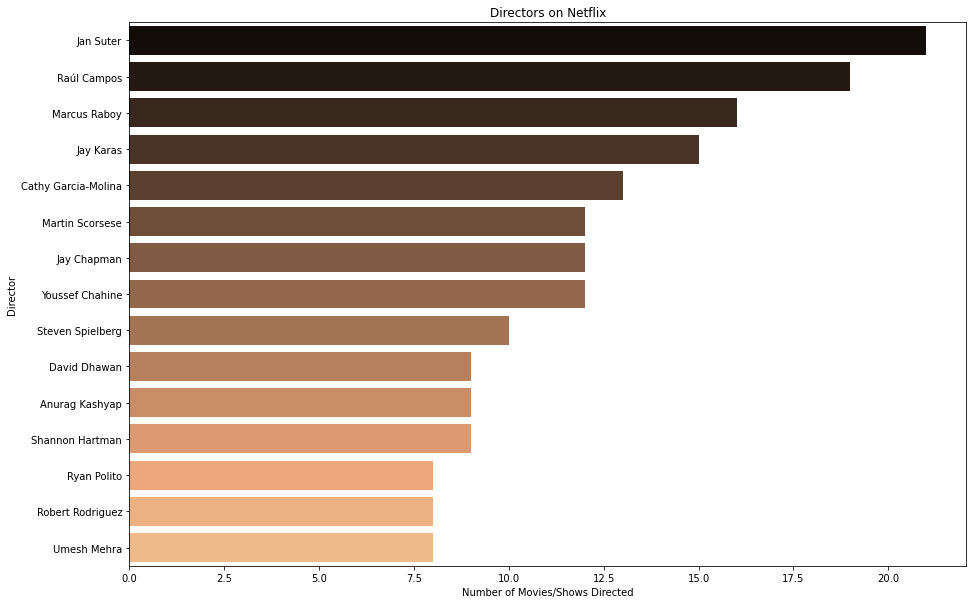

In [325]:
a=df[df.director != 'unknown'].loc[:,['show_id','title','director', 'cast']].copy()
director = (a['director'].to_list())

newlist = []
for genre in director:
  if ',' in genre:
    a = genre.split(', ')
    newlist = newlist + a
  else:
    newlist.append(genre)
country_list = pd.DataFrame({'Director' : newlist, 'id':np.arange(0,len(newlist),1)})
a = country_list.groupby('Director').agg({'id':'count'}).sort_values('id', ascending= False).reset_index().head(15)
plt.figure(figsize=(15,10))
a = sns.barplot(y = 'Director', x = 'id',data = a , palette= 'copper')
a = plt.title('Directors on Netflix')
a = plt.ylabel('Director')
a = plt.xlabel('Number of Movies/Shows Directed')
top10directors = country_list.groupby('Director').agg({'id':'count'}).sort_values('id', ascending= False).reset_index().head(10)['Director'].to_list()

####**OBSERVATIONS**
---
> **Top Directors on Netflix are:**
1. **Jan Suter**
2.**Raul Campos**
3.**Marcus Raboy**
4.**Jay Karas**
5.**Cathy Garcia-Molina**

---

###**Frequent Cast on Netflix**

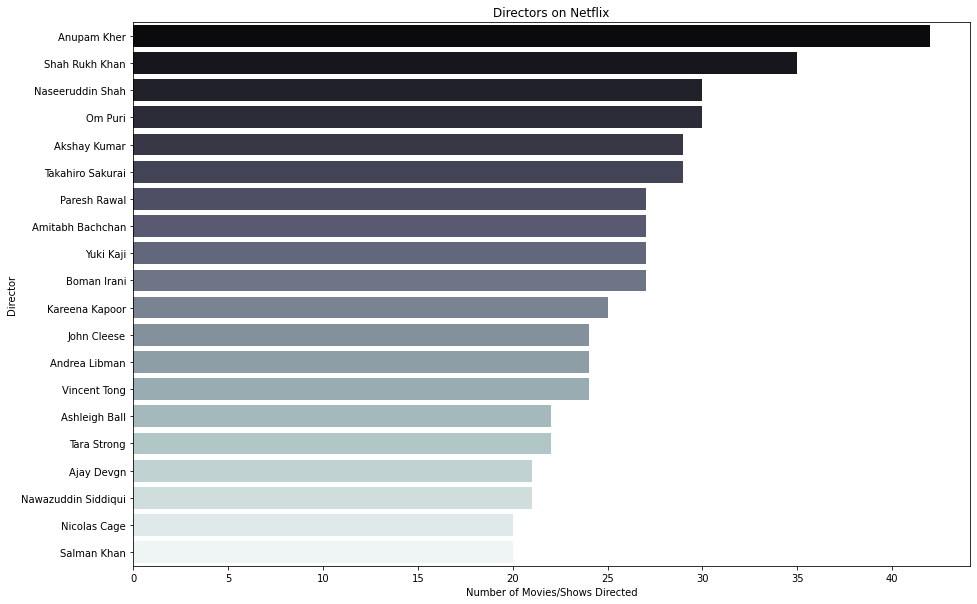

In [326]:
a=df[df.cast != 'unknown'].loc[:,['show_id','title','director', 'cast']].copy()
cast = (a['cast'].to_list())

newlist = []
for genre in cast:
  if ',' in genre:
    a = genre.split(', ')
    newlist = newlist + a
  else:
    newlist.append(genre)
country_list = pd.DataFrame({'Actor' : newlist, 'id':np.arange(0,len(newlist),1)})
a = country_list.groupby('Actor').agg({'id':'count'}).sort_values('id', ascending= False).head(20).reset_index()
plt.figure(figsize=(15,10))
a = sns.barplot(y = 'Actor', x = 'id',data = a , palette= 'bone')
a = plt.title('Directors on Netflix')
a = plt.ylabel('Director')
a = plt.xlabel('Number of Movies/Shows Directed')
top10actors = country_list.groupby('Actor').agg({'id':'count'}).sort_values('id', ascending= False).head(20).reset_index()['Actor'].to_list()

####**OBSERVATIONS**
---
> **Top Actors on Netflix are:**
1. **Anupam Kher**
2.**Shah Rukh Khan**
3.**Naseeruddin Shah**
4.**Om Puri**
5.**Akshay Kumar**

---

###**Duration of Movies on Netflix**

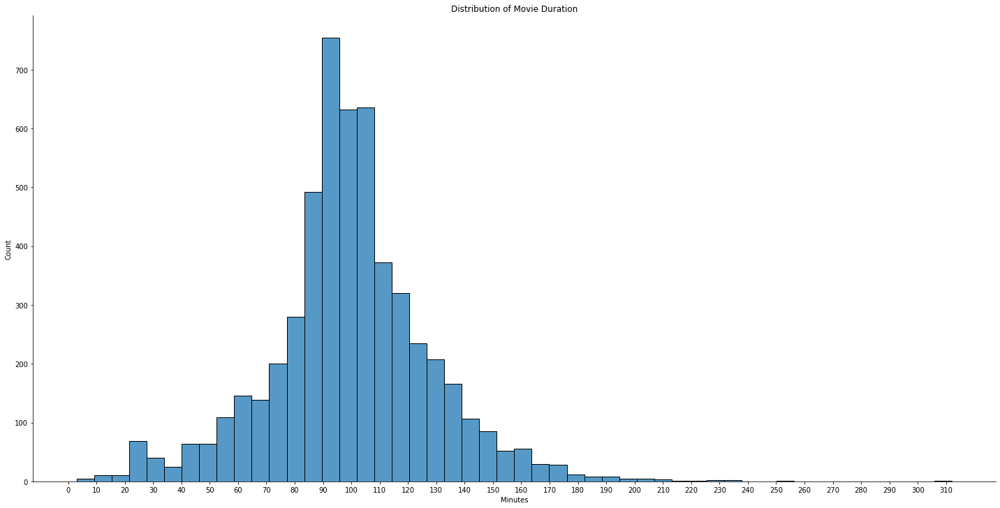

In [327]:
a=df[df['type']=='Movie'].loc[:,['show_id','duration']].copy()
cast = (a['duration'].to_list())

newlist = []
for genre in cast:
  newlist.append(int(genre.split(' ')[0]))
country_list = pd.DataFrame({'Duration' : newlist, 'id':np.arange(0,len(newlist),1)})
a = sns.displot(x= 'Duration',  data = country_list, kind = 'hist', height=10, aspect=2, bins = 50)
a = plt.title('Distribution of Movie Duration')
a = plt.xlabel('Minutes')
a = plt.xticks(ticks = np.arange(0,country_list.Duration.max()+1,10))

####**OBSERVATIONS**
> * **Most movies on Netflix have a duration range from 90 to 110 minutes**

###**Duration of TV shows on Netflix**

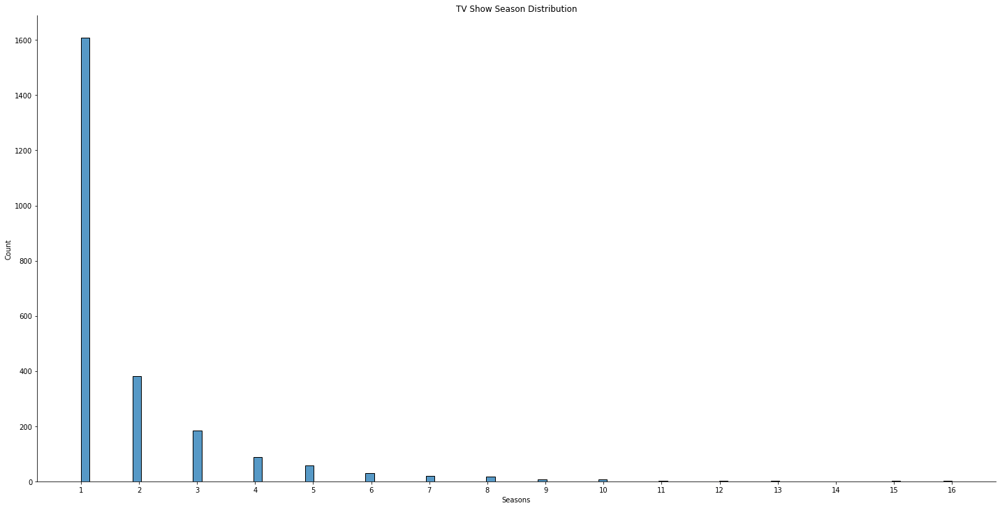

In [328]:
a=df[df['type']!='Movie'].loc[:,['show_id','duration']].copy()
cast = (a['duration'].to_list())

newlist = []
for genre in cast:
  newlist.append(int(genre.split(' ')[0]))
country_list = pd.DataFrame({'Seasons' : newlist, 'id':np.arange(0,len(newlist),1)})
a = sns.displot(x= 'Seasons',  data = country_list, kind = 'hist', height=10, aspect=2)
a = plt.title('TV Show Season Distribution')
a = plt.xlabel('Seasons')
a = plt.xticks(ticks = np.arange(country_list.Seasons.min(),country_list.Seasons.max()+1,1))

####**OBSERVATIONS**
> * **Most TV shows on Netflix have a span of 1 season only**

#**#2 UNDERSTANDING CONTENT PRODUCED IN DIFFERENT COUNTRIES**

In [329]:
a = df[df['country'] != 'unknown country'].loc[:,['show_id','title','country','listed_in','Genres']].copy()

In [330]:
#function to convert string type to list 
def operation(row,string):
  return row[string].split(', ')
a['listed_in'] = a.apply(lambda x: operation(x,'listed_in'), axis = 1)
a['country'] = a.apply(lambda x: operation(x,'country'), axis = 1)

In [331]:
#explodes the list of categories and genres in each row to individual rows
a = a.explode('Genres').explode('country')

In [332]:
a = a.groupby(['country','Genres']).agg({'show_id':'count'}).reset_index() #table contains number of videos belonging to each genre from different countries

In [333]:
#function to return the indeces that contain the top10 countries with the top 10 genres viewed
def selectindex(row, attribute, list):
  b = row[attribute]
  boolean = b in list
  return boolean

index = a.apply(lambda x: selectindex(x, 'country',top10countries), axis = 1)
newindex = a[index].apply(lambda x: selectindex(x, 'Genres',top15genres), axis = 1)

In [334]:
newdata = a[index][newindex] #data that contains the number videos in the top 15 genres in the top 10 countries

In [335]:
gyr = ['#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f']

Text(0, 0.5, 'NUMBER OF SHOWS & MOVIES')

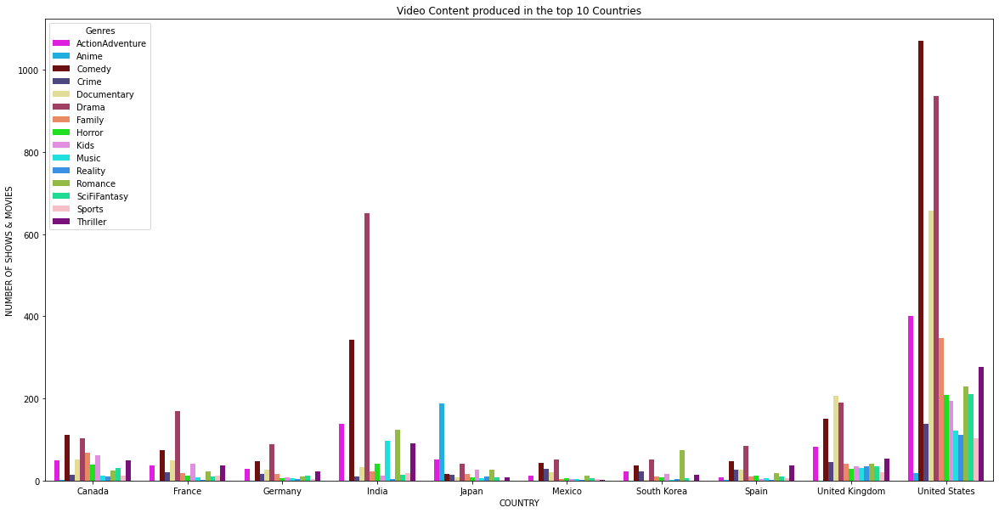

In [336]:
a = plt.figure(figsize=(20,10))
sns.barplot(x = newdata['country'], y = newdata['show_id'], hue = newdata['Genres'], palette= sns.color_palette(gyr[:23]) )
plt.title('Video Content produced in the top 10 Countries')
plt.xlabel('COUNTRY')
plt.ylabel('NUMBER OF SHOWS & MOVIES')

# **#3 Has Netflix Been Focusing Increasingly on TV Shows as compared to movies**

In [337]:
content = df.loc[:,['title','date_added','release_year', 'duration', 'type']].dropna().copy()

In [338]:
content['date_added'] = content['date_added'].dt.year

In [339]:
#Assuming TV shows release new seasons every year, we'll be adding a duplicate of the show for each season.
def season(row):
  release = row['release_year']
  added = row['date_added']

  if row['type'] =='TV Show':
    seasons = int(row['duration'][0])
    b = []
    for i in range(1, seasons+1):
      if i ==1:
        b.append(release)
      else:
        b.append(b[-1]-1)
    a = b
  else:
    a = []
    a.append(row['release_year'])      
  
  return a

content['Released Years'] = content.apply(lambda x: season(x),axis=1)

In [340]:
compare = content.explode('Released Years')

In [341]:
tv = compare[compare['type'] == 'TV Show'].groupby(['date_added']).agg(count = ('title','count')).reset_index()
tv['type'] = 'TV'
movie = compare[compare['type'] != 'TV Show'].groupby(['date_added']).agg(count = ('title','count')).reset_index()
movie['type'] = 'Movie'

In [342]:
data = pd.concat([tv, movie], axis = 0)

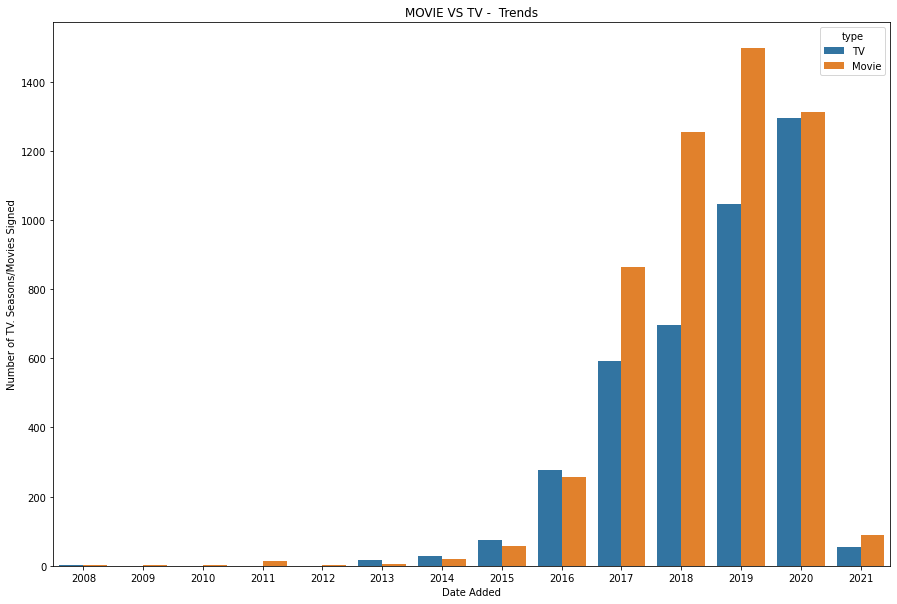

In [343]:
plt.figure(figsize = (15,10))
sns.barplot(x = 'date_added', y='count', hue = 'type', data = data)
plt.title('MOVIE VS TV -  Trends')
plt.xlabel('Date Added')
_ = plt.ylabel('Number of TV. Seasons/Movies Signed')


In [344]:
tv = compare[compare['type'] == 'TV Show'].groupby(['Released Years']).agg(count = ('title','count')).reset_index()
tv['type'] = 'TV'
movie = compare[compare['type'] != 'TV Show'].groupby(['Released Years']).agg(count = ('title','count')).reset_index()
movie['type'] = 'Movie'

In [345]:
data = pd.concat([tv, movie], axis = 0)

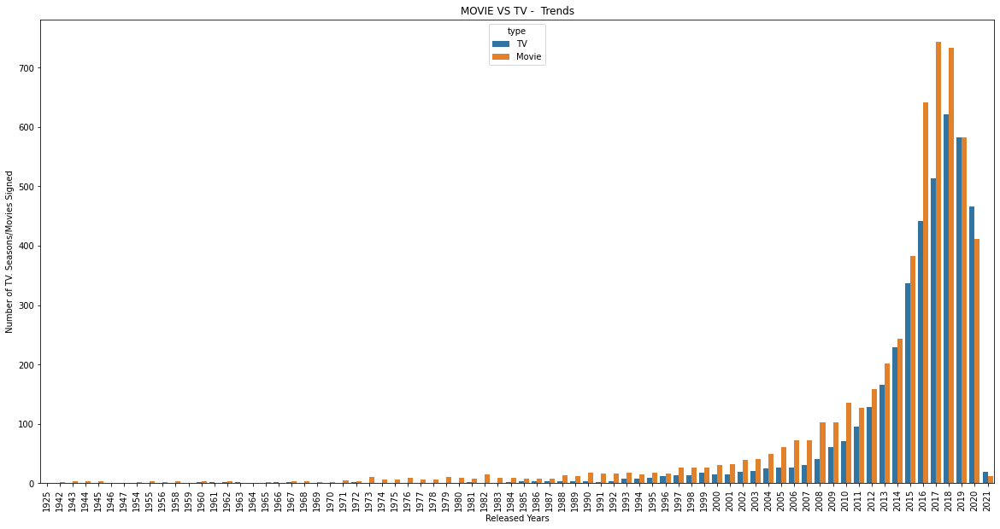

In [346]:
plt.figure(figsize = (20,10))
sns.barplot(x = 'Released Years', y='count', hue = 'type', data = data)
plt.title('MOVIE VS TV -  Trends')
plt.xlabel('Released Years')
plt.xticks(rotation = 90)
_ = plt.ylabel('Number of TV. Seasons/Movies Signed')



# TEXT PREPROCESSING

This process involves converting the 'Description' of the show/movie into a machine interprettable form. Here we convert all text to lower case, remove punctuations and remove irrelevant words (so that only words that provide context are retained). Here similar words are unified to save memory and processing time as well. Individual words and group of words (n grams) are also collected to extract context related details.


##FEATURE ENGINEERING LISTED_IN

Genres are extracted and re-defined accordingly

In [347]:
a = df.copy()

In [348]:

a['listed_in'] = a.listed_in.apply(lambda row: row.split(', '))
a.explode('listed_in')['listed_in'].unique()

array(['International TV Shows', 'TV Dramas', 'TV Sci-Fi & Fantasy',
       'Dramas', 'International Movies', 'Horror Movies',
       'Action & Adventure', 'Independent Movies', 'Sci-Fi & Fantasy',
       'TV Mysteries', 'Thrillers', 'Crime TV Shows', 'Docuseries',
       'Documentaries', 'Sports Movies', 'Comedies', 'Anime Series',
       'Reality TV', 'TV Comedies', 'Romantic Movies',
       'Romantic TV Shows', 'Science & Nature TV', 'Movies',
       'British TV Shows', 'Korean TV Shows', 'Music & Musicals',
       'LGBTQ Movies', 'Faith & Spirituality', "Kids' TV",
       'TV Action & Adventure', 'Spanish-Language TV Shows',
       'Children & Family Movies', 'TV Shows', 'Classic Movies',
       'Cult Movies', 'TV Horror', 'Stand-Up Comedy & Talk Shows',
       'Teen TV Shows', 'Stand-Up Comedy', 'Anime Features',
       'TV Thrillers', 'Classic & Cult TV'], dtype=object)

In [349]:
replacing_genre = {'International TV Shows': '-',
                   'TV Dramas': 'Drama',
                   'TV Sci-Fi & Fantasy': 'SciFiFantasy',
                   'Dramas': 'Drama' ,
                   'International Movies': '-',
                   'Horror Movies': 'Horror',
                   'Action & Adventure': 'ActionAdventure',
                   'Independent Movies': '-',
                   'Sci-Fi & Fantasy': 'SciFiFantasy',
                  'TV Mysteries': 'Mystery'       ,
                  'Thrillers': 'Thriller',
                   'Crime TV Shows': 'Crime',
                   'Docuseries': 'Documentary',
                  'Documentaries': 'Documentary', 'Sports Movies': 'Sports',
                   'Comedies':'Comedy',
                   'Anime Series': 'Anime',
                  'Reality TV': 'Reality',
                   'TV Comedies': 'Comedy',
                   'Romantic Movies': 'Romance',
                  'Romantic TV Shows': 'Romance', 
                   'Science & Nature TV': 'Science',
                   'Movies': '-',
                  'British TV Shows': '-',
                   'Korean TV Shows': '-',
                   'Music & Musicals': 'Music',
                  'LGBTQ Movies': 'LGBTQ',
                   'Faith & Spirituality': 'Spirituality', 
                   "Kids' TV": 'Kids',
                  'TV Action & Adventure': 'ActionAdventure',
                   'Spanish-Language TV Shows': '-',
                  'Children & Family Movies': 'Family', 
                   'TV Shows': '-',
                   'Classic Movies': 'Classic',
                  'Cult Movies': 'Cult',
                   'TV Horror': 'Horror',
                   'Stand-Up Comedy & Talk Shows':'Comedy, TalkShow',
                  'Teen TV Shows': 'Teen', 'Stand-Up Comedy':'Comedy', 
                   'Anime Features':'Anime',
                  'TV Thrillers': 'Thriller',
                   'Classic & Cult TV':'Classic, Cult'}

In [350]:
def genre_replace(row, replacing_genre = replacing_genre):
  new_text = []
 
  for word in (row['listed_in']):
    if word in replacing_genre:
      if '-' not in replacing_genre[word]:
       new_text.append(replacing_genre[word])
    else:
      print(word, 'not present in dictionary')

  return(', '.join(new_text))
  

df['Genres'] = a.apply(lambda row: genre_replace(row),axis=1)
df['Genres'] = df['Genres'].apply(lambda row: row.split(', '))

In [351]:

(df.explode('Genres')['Genres'].unique())

array(['Drama', 'SciFiFantasy', 'Horror', 'ActionAdventure', 'Mystery',
       'Thriller', 'Crime', 'Documentary', 'Sports', 'Comedy', 'Anime',
       'Reality', 'Romance', 'Science', '', 'Music', 'LGBTQ',
       'Spirituality', 'Kids', 'Family', 'Classic', 'Cult', 'TalkShow',
       'Teen'], dtype=object)

In [352]:
df['Genres']

0                 [Drama, SciFiFantasy]
1                               [Drama]
2                              [Horror]
3       [ActionAdventure, SciFiFantasy]
4                               [Drama]
                     ...               
7782                            [Drama]
7783                     [Drama, Music]
7784               [Documentary, Music]
7785                          [Reality]
7786               [Documentary, Music]
Name: Genres, Length: 7787, dtype: object

##COMBINING Top CAST, DIRECTOR and ListedIn into single text attributes

We are extracting non-plot related text details about the movie/show like lead actors, director, country and categories it is being listed in on the platform

In [353]:
def combine(row):
  text = ' '.join(row['Genres']).lower()
  if row['cast'] != 'unknown':
    cast_list = [actor.replace(' ', '') for actor in row['cast'].split(', ')]
    if len(cast_list) < 5:
      text = text + ' ' + ' '.join(cast_list[:]).lower()
    else :
      text = text + ' ' + ' '.join(cast_list[:5]).lower()
  if row['director'] !='unknown':
    director_list = ' '.join([director.replace(' ', '') for director in row['director'].split(', ')])
    text = text + ' ' + director_list.lower()

  return text
df['Movie Deets'] = df.apply(lambda row: combine(row), axis = 1)


In [354]:
df.head()['Movie Deets'].to_list()

['drama scififantasy joãomiguel biancacomparato michelgomes rodolfovalente vanezaoliveira',
 'drama demiánbichir héctorbonilla oscarserrano azaliaortiz octaviomichel jorgemichelgrau',
 'horror teddchan stellachung henleyhii lawrencekoh tommykuan gilbertchan',
 'actionadventure scififantasy elijahwood johnc.reilly jenniferconnelly christopherplummer crispinglover shaneacker',
 'drama jimsturgess kevinspacey katebosworth aaronyoo lizalapira robertluketic']

In [355]:
#importing necessary libraries for text processing
import nltk 
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string 
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer

In [356]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [357]:
 nltk.download('stopwords')
 

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [358]:
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

### WORD TOKENIZATION
Tokenization breaks the raw text into words, sentences called tokens. These tokens help in understanding the context or developing the model for the NLP. The tokenization helps in interpreting the meaning of the text by analyzing the sequence of the words.

In [359]:
import string

In [360]:
def tokenizer(txt):  
  tokens = word_tokenize(txt) 
  
  return tokens
df['Processed Description'] = df['description'].apply(tokenizer)
df['Processed Movie Deets'] = df['Movie Deets'].apply(tokenizer)

###PUNCTUATION REMOVAL

In [361]:
regular_punct = list(string.punctuation)
def remove_punctuation(text,punct_list):
  tokens = text
  new_tok = []
  for i in tokens:
    word = i
    for punctuation in list(string.punctuation):
      word = word.replace(punctuation, ' ')
    if word.replace(' ','').isalnum():
      new_tok.append(word)

  return ' '.join(new_tok).split(' ')

df['Processed Description'] = df['Processed Description'].apply(lambda x : remove_punctuation(x, regular_punct))
df['Processed Movie Deets'] = df['Processed Movie Deets'].apply(lambda x : remove_punctuation(x, regular_punct))


### STOP WORD REMOVAL

In [362]:
stop_words = set(stopwords.words('english')) 

def remove_stop(tokens, stopwords):
  return [t.lower() for t in tokens if t.lower() not in stopwords]


df['Processed Description'] = df['Processed Description'].apply(lambda x : remove_stop(x, stop_words))

a = df.copy() #will be used for wordcloud later on

###STEMMING
Stemming is the process of producing morphological variants of a root/base word. Stemming programs are commonly referred to as stemming algorithms or stemmers.

In [363]:
ps = PorterStemmer()

def stem_text(text):  
  stemmed = []
  for word in text:
    stemmed.append(ps.stem(word))
  return stemmed


df['Processed Description'] = df['Processed Description'] .apply(lambda x : stem_text(x))



In [364]:
def joiner(text_list):
  new = []
  for text in text_list:
    if text == ' ' or text == '' :
      pass
    else:
      new.append(text)
      
  return ' '.join(new)

df['Processed Description'] = df['Processed Description'] .apply(lambda x : joiner(x))
df['Processed Movie Deets'] = df['Processed Movie Deets'].apply(lambda x : joiner(x))

In [365]:
df.loc[:,['description','Processed Description','Movie Deets',	'Processed Movie Deets']].head(1).T

,0
description,In a future where the elite inhabit an island ...
Processed Description,futur elit inhabit island paradis far crowd sl...
Movie Deets,drama scififantasy joãomiguel biancacomparato ...
Processed Movie Deets,drama scififantasy joãomiguel biancacomparato ...


## Vectorizing Texts 

In [366]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

##BAG OF WORDS WORDCLOUD GENERATION of CONTENT DESCRIPTION BASED ON GENRE

In [367]:
from wordcloud import WordCloud

In [368]:
genres = df.explode('Genres').Genres.unique()

In [369]:
copy =  a.explode('Genres').copy()
a = copy.copy()
a['Processed Description'] = a['Processed Description'] .apply(lambda x : joiner(x))

<Figure size 2520x2160 with 0 Axes>

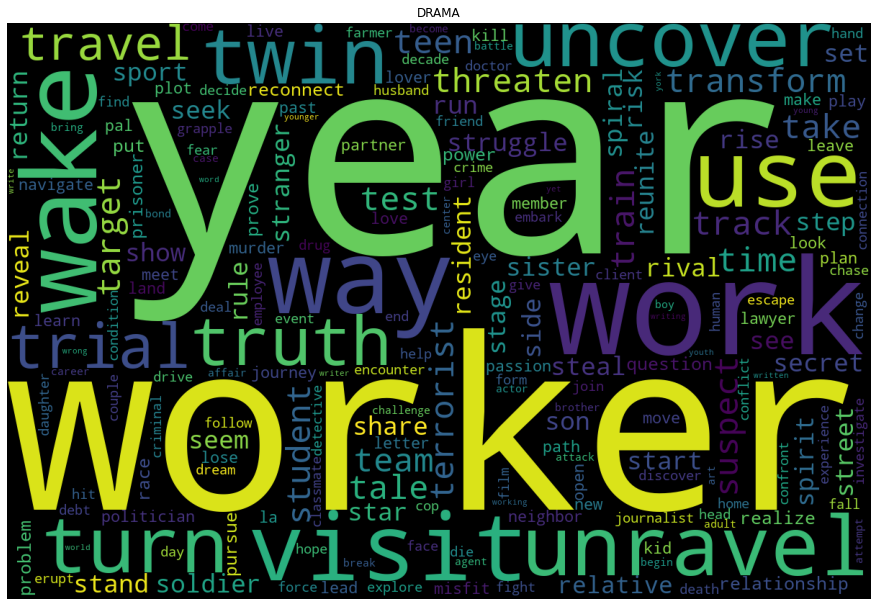

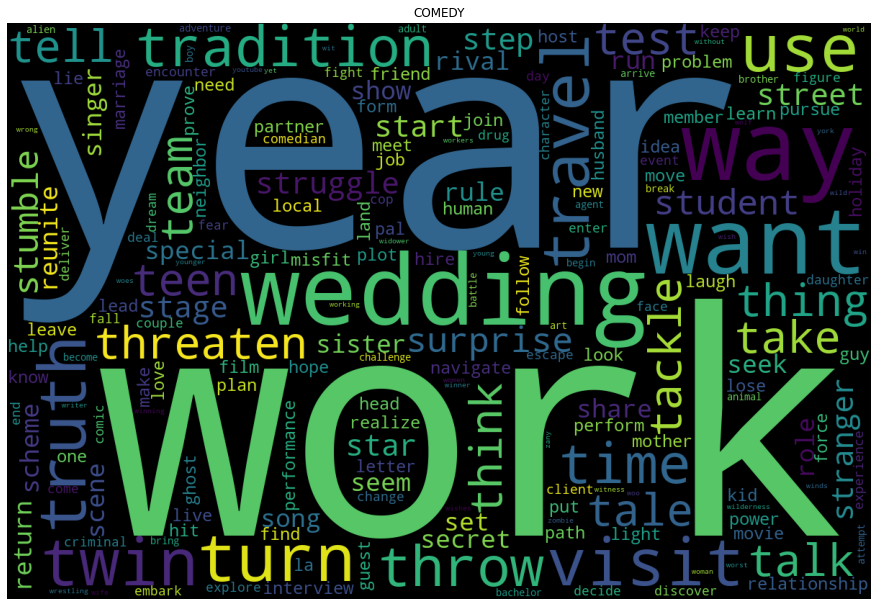

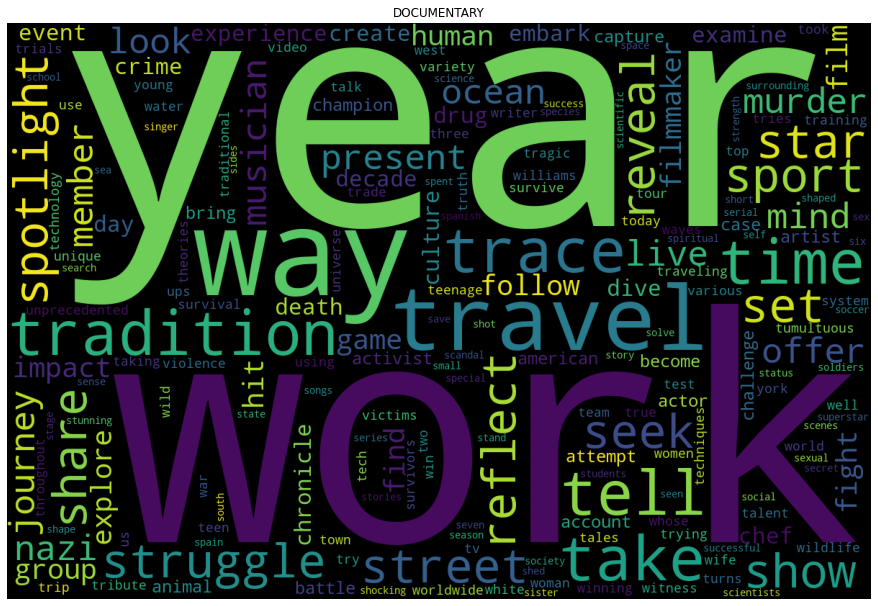

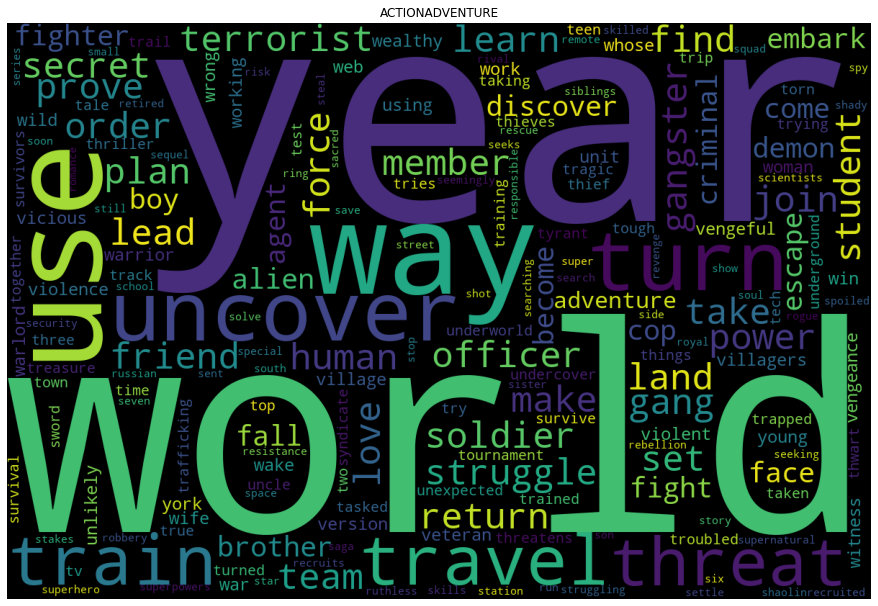

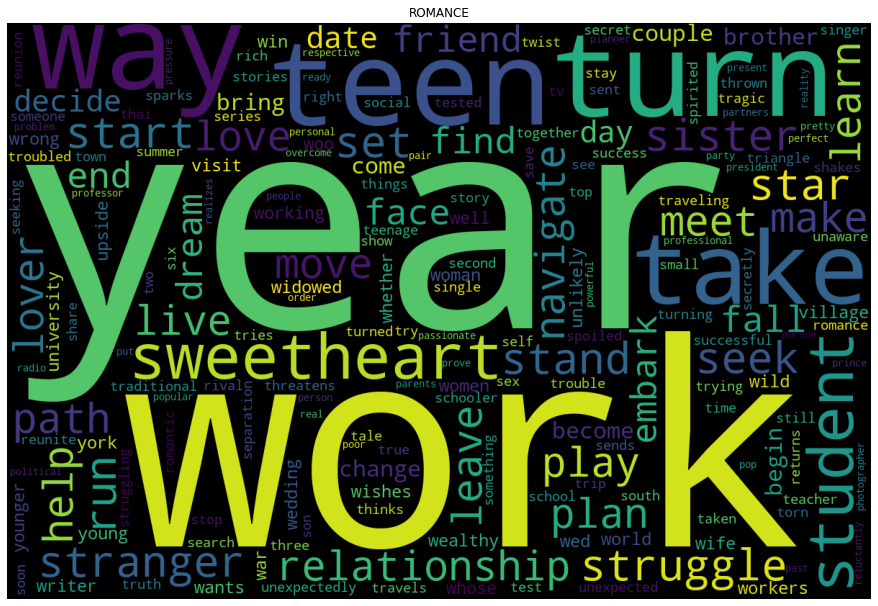

...

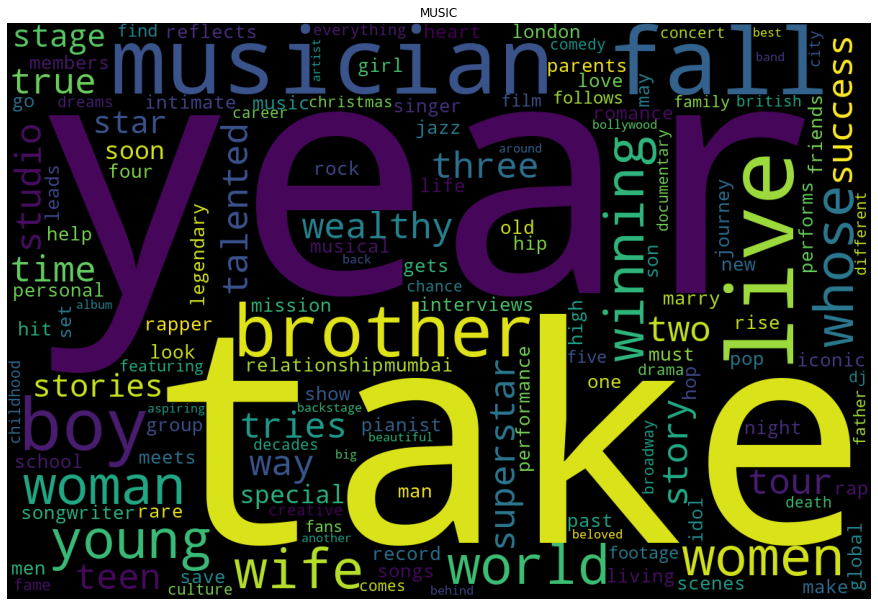

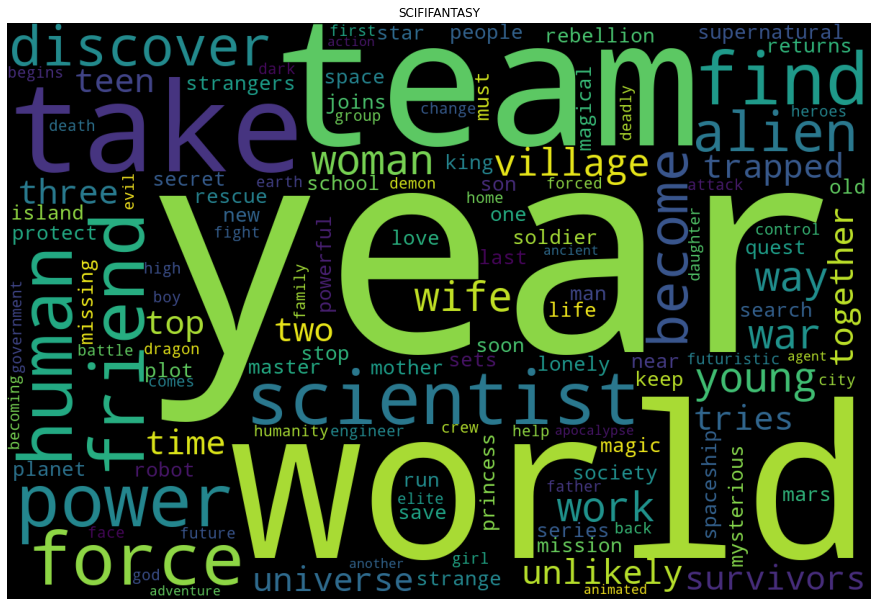

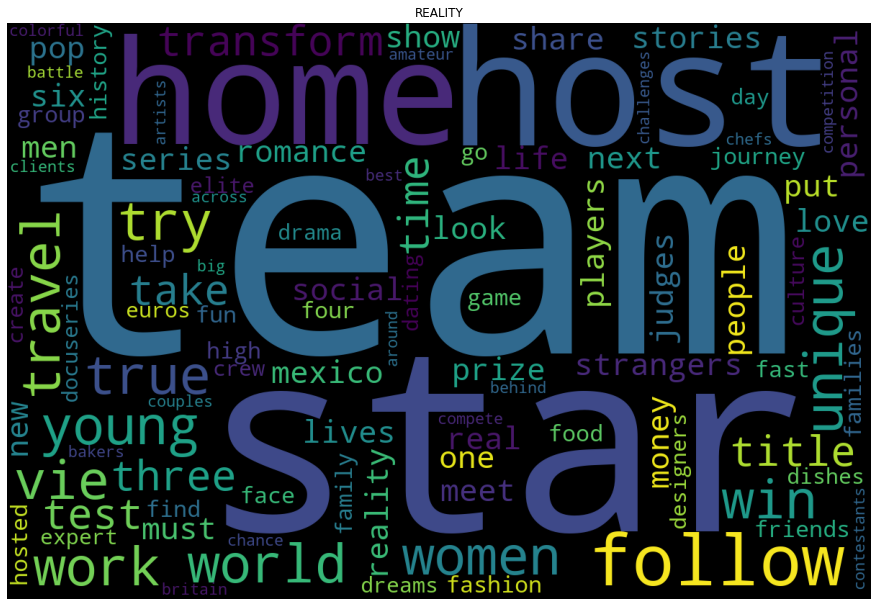

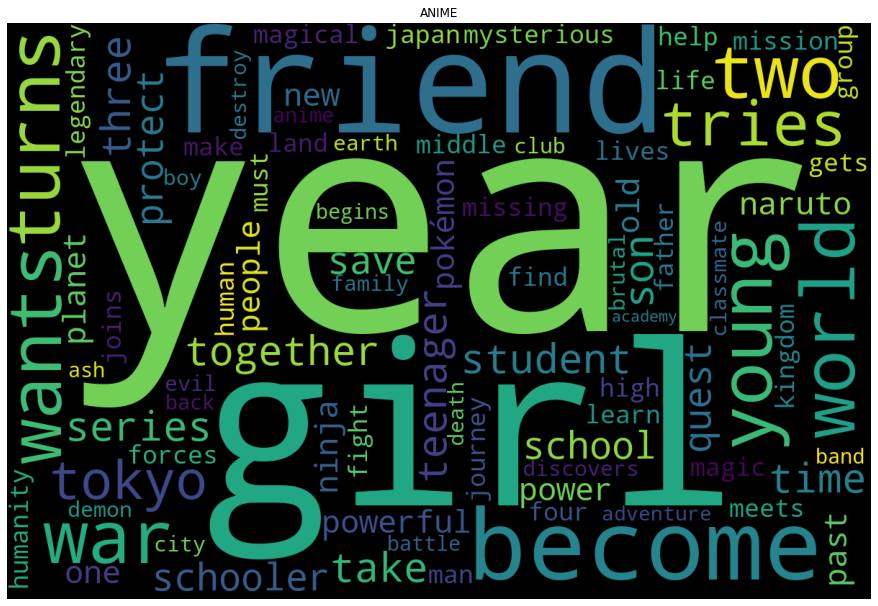

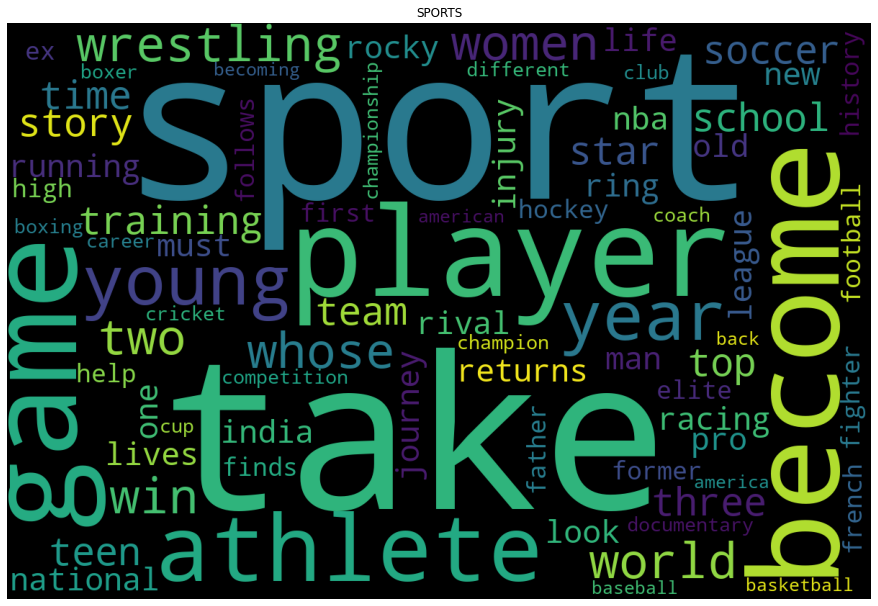

In [370]:
plt.figure(figsize=(35, 30))
plt.suptitle("Word Cloud for Different Genres", fontsize=18, y=0.5)

for genre in top15genres:
  if genre != '':
    
    count_description_vectorizer = CountVectorizer(ngram_range = (1,1), min_df = 5, max_df = 0.7)
    # fit the count vectorizer using the text data
    count_description_vectorizer.fit(a[a.Genres == genre]['Processed Description'])
    dictionary = count_description_vectorizer.vocabulary_.items()

    vocab = []
    count_of_vocab = []
    # Iterate through each vocab and count append the value to designated lists
    for key, value in dictionary:
        vocab.append(key)
        count_of_vocab.append(value)

    count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)}).sort_values('Count', ascending= False)
    comment_words = ' '.join(count_description_df['Token'].to_list())
    
    wordcloud = WordCloud(width = 1200, height = 800,
                    background_color ='black',
                    min_font_size = 10).generate(comment_words)
                    # plot the WordCloud image 
    plt.figure(figsize = (12, 8), facecolor = None)                     
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad = 0)
    plt.title(genre.upper())
    
    plt.show()


##BIGRAM BAG OF WORDS WORDCLOUD GENERATION of CONTENT DESCRIPTION BASED ON GENRE

In [371]:
a = copy.copy()
a['Processed Description'] = a['Processed Description'] .apply(lambda x : joiner(x))

<Figure size 2520x2160 with 0 Axes>

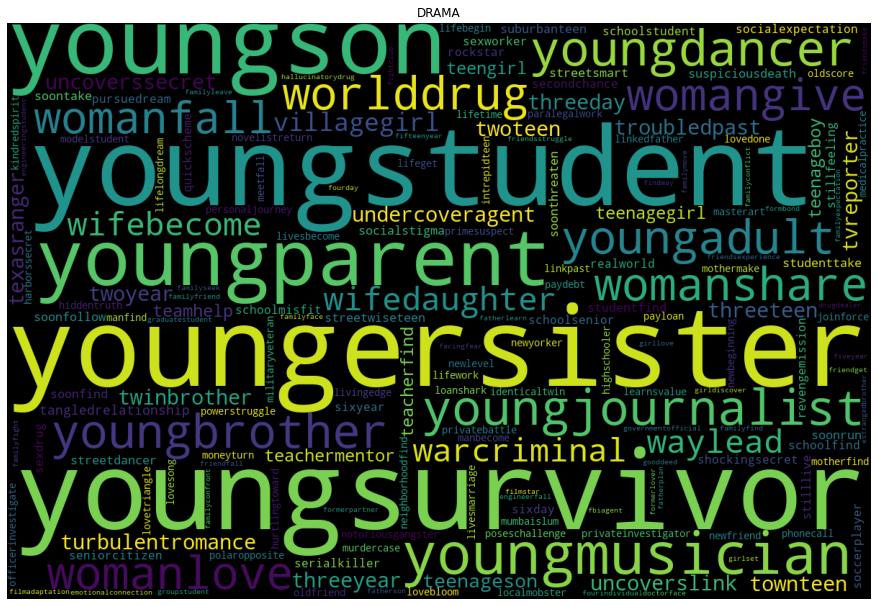

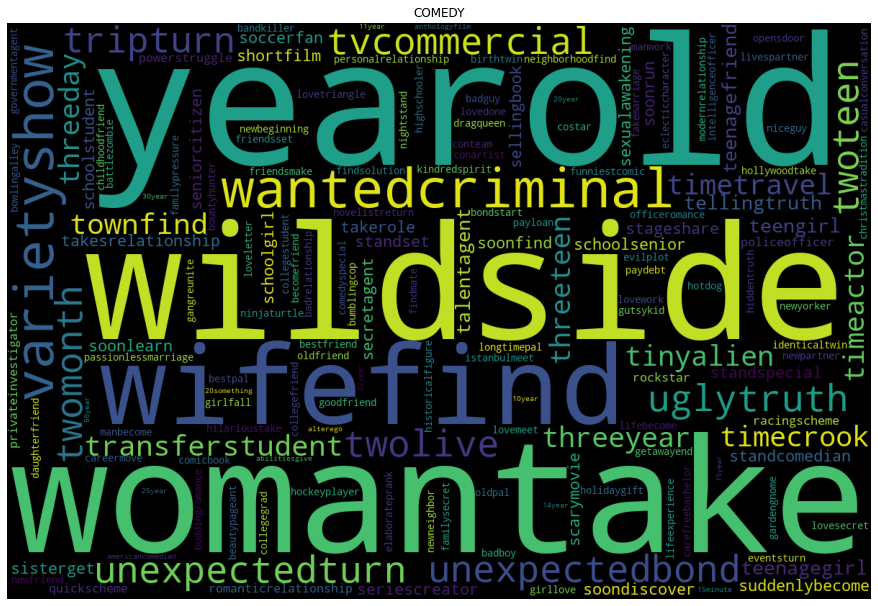

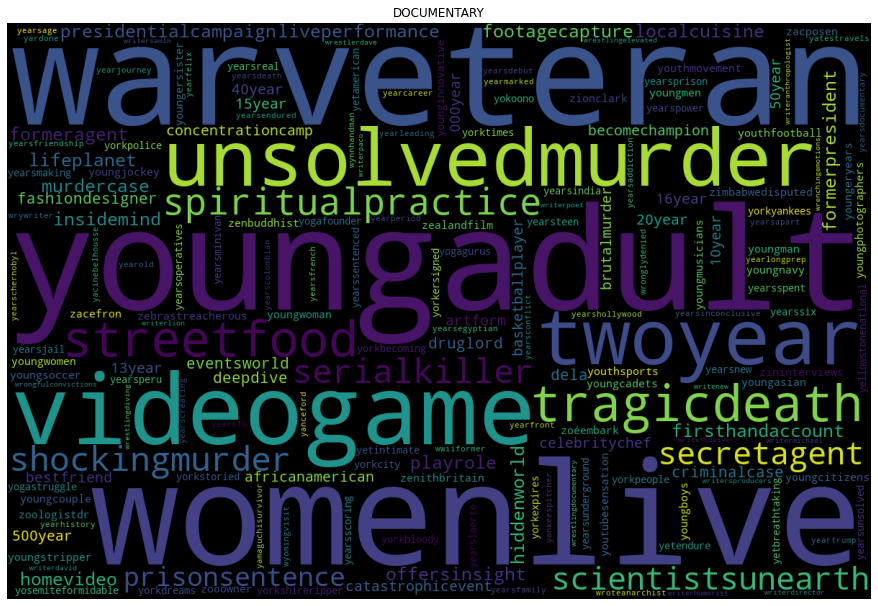

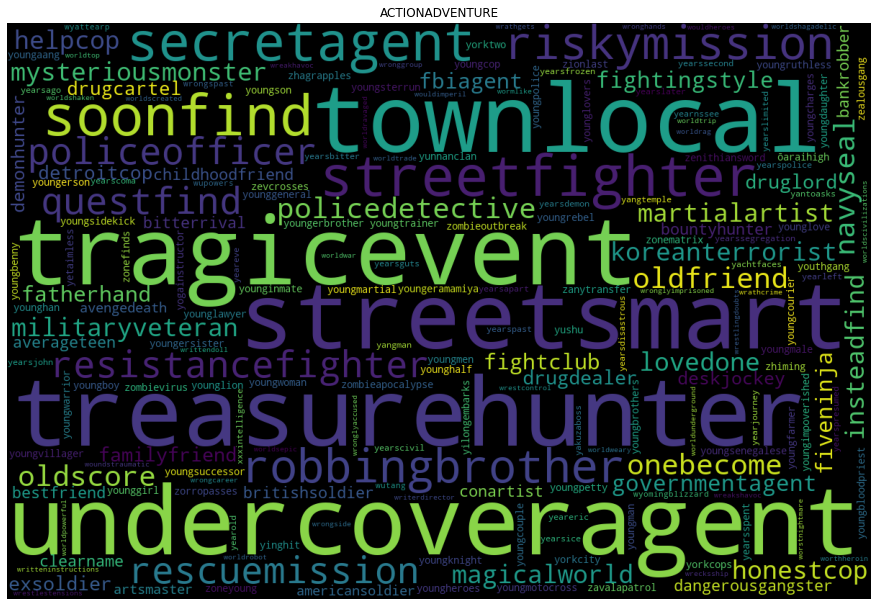

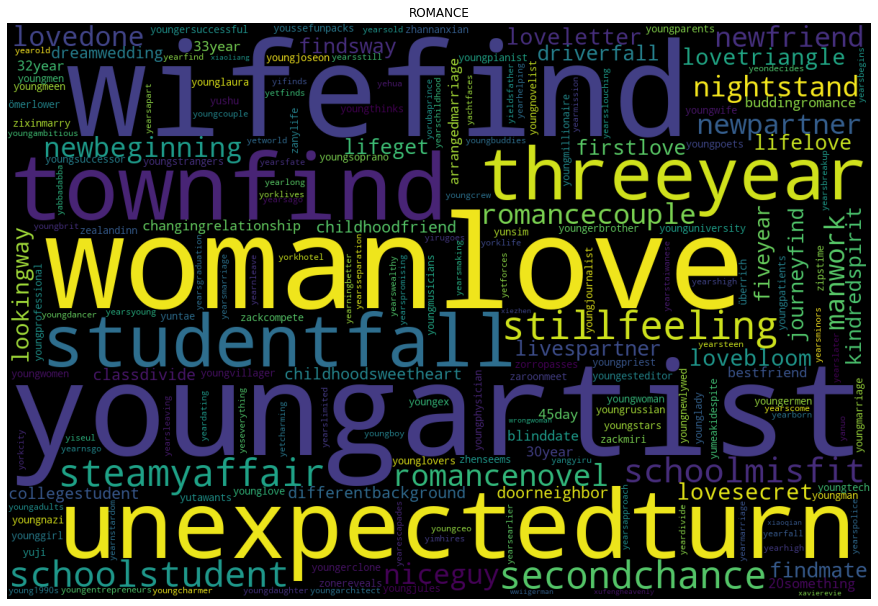

...

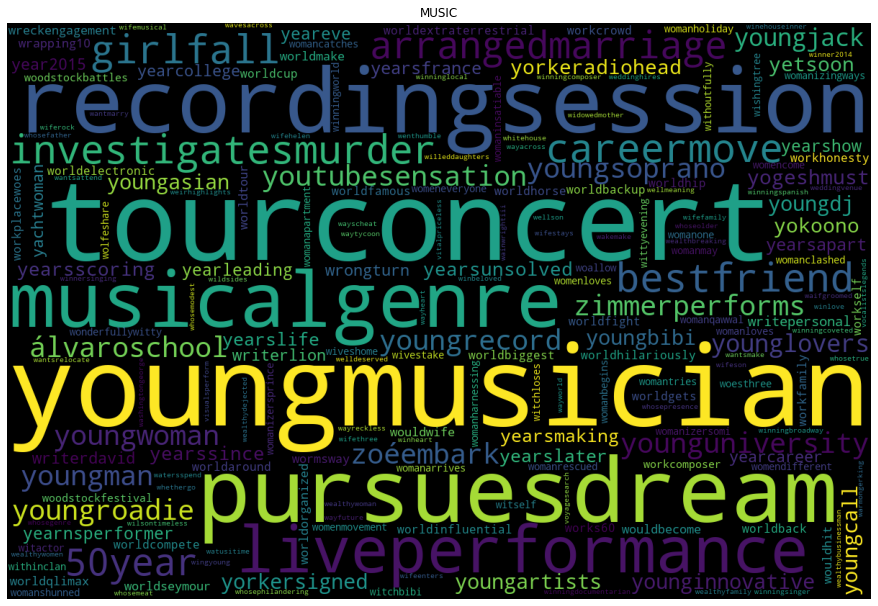

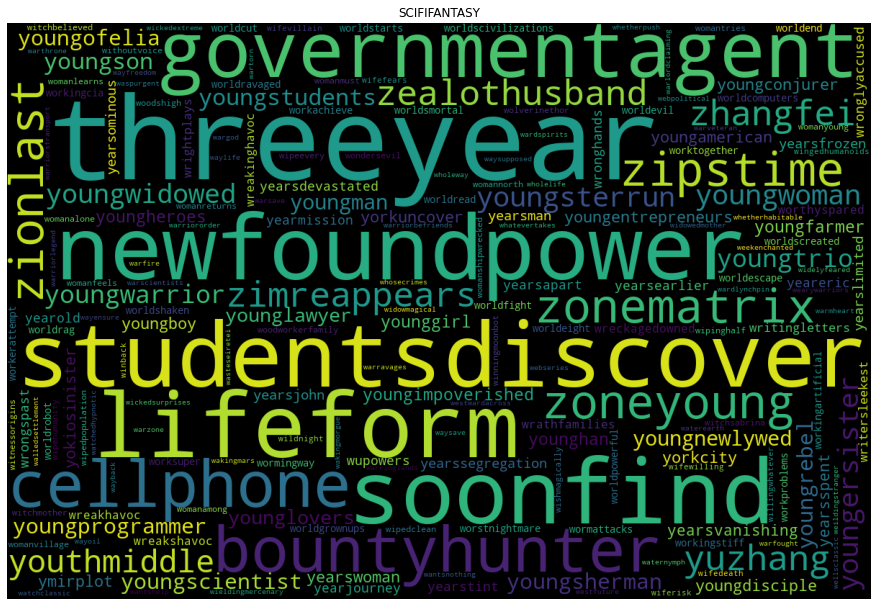

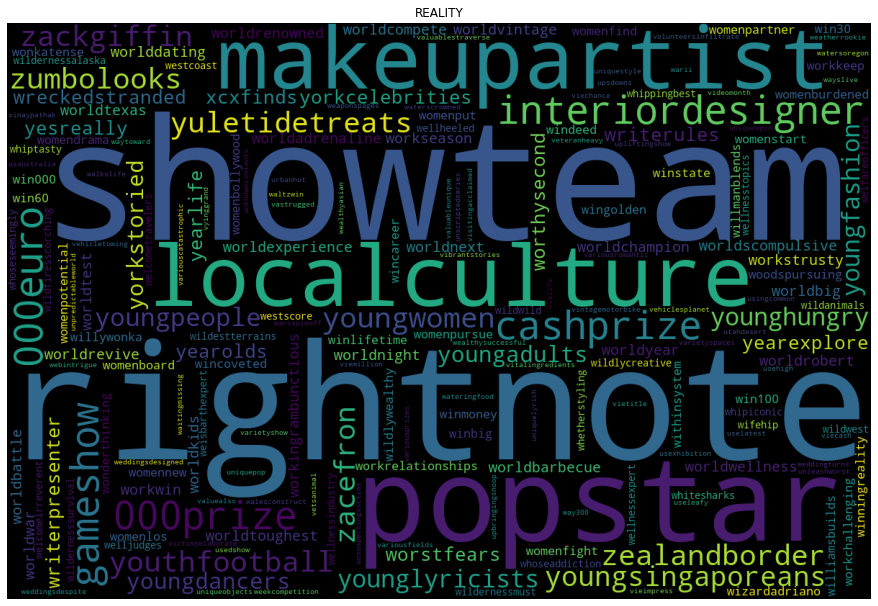

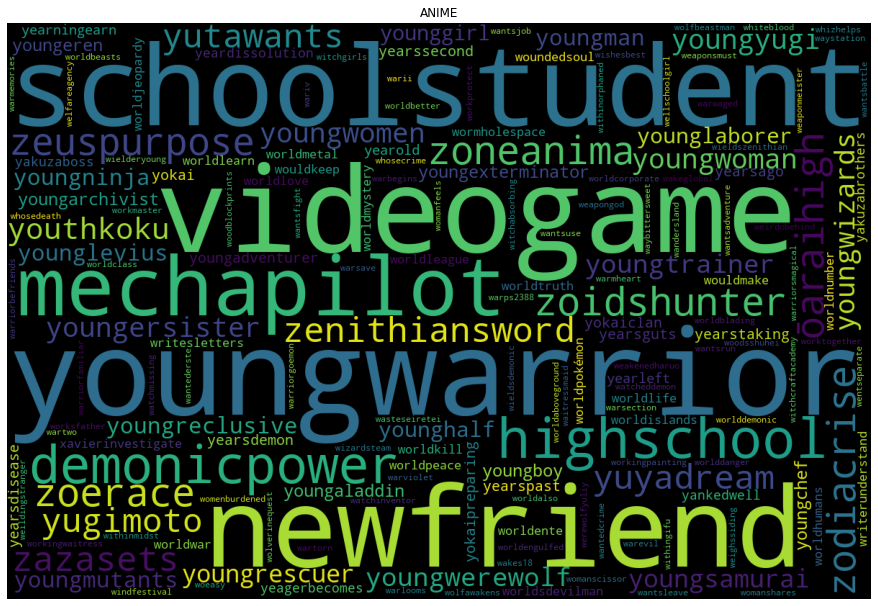

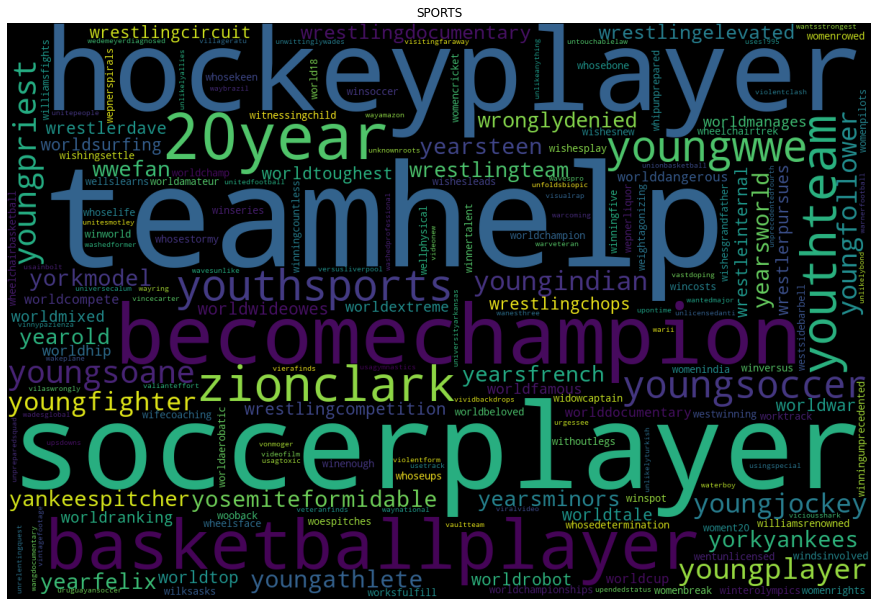

In [372]:
plt.figure(figsize=(35, 30))
plt.suptitle("Word Cloud for Different Genres", fontsize=18, y=0.5)

for genre in top15genres:
  if genre != '':
    
    count_description_vectorizer = CountVectorizer(ngram_range = (2,2), min_df = 1, max_df = 0.7)
    # fit the count vectorizer using the text data
    count_description_vectorizer.fit(a[a.Genres == genre]['Processed Description'])
    dictionary = count_description_vectorizer.vocabulary_.items()

    vocab = []
    count_of_vocab = []
    # Iterate through each vocab and count append the value to designated lists
    for key, value in dictionary:
        vocab.append(key)
        count_of_vocab.append(value)


    count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)}).sort_values('Count', ascending = False)
    comment_words = ' '.join(count_description_df['Token'].apply(lambda row: ''.join(row.split(' '))).to_list())
        
    wordcloud = WordCloud(width = 1200, height = 800,
                    background_color ='black',
                    min_font_size = 10).generate(comment_words)
                    # plot the WordCloud image 
    plt.figure(figsize = (12, 8), facecolor = None)                     
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad = 0)
    plt.title(genre.upper())
    
    plt.show()

### Count Vectorizer

DESCRIPTION

In [290]:
# terms should occur at least in five documents and shouldn't repeat more than 70% of the times
# extracting single words, bi-grams and tri-grams
count_description_vectorizer = CountVectorizer(ngram_range = (1,1), min_df = 10, max_df = 0.7)
# fit the count vectorizer using the text data
count_description_vectorizer.fit(df['Processed Description'])

#converting processed text into tfidf vector
count_description_vector = count_description_vectorizer.transform(df['Processed Description'])
# Collect the vocabulary items used in the vectorizer
dictionary = count_description_vectorizer.vocabulary_.items()


In [291]:
count_description_vector.shape

(7787, 2126)

In [292]:
vocab = []
count_of_vocab = []
# Iterate through each vocab and count append the value to designated lists
for key, value in dictionary:
    vocab.append(key)
    count_of_vocab.append(value)

count_description_df = pd.DataFrame({'Token':vocab, 'Count':np.array(count_of_vocab)})
count_description_df.set_index('Token',inplace = True)

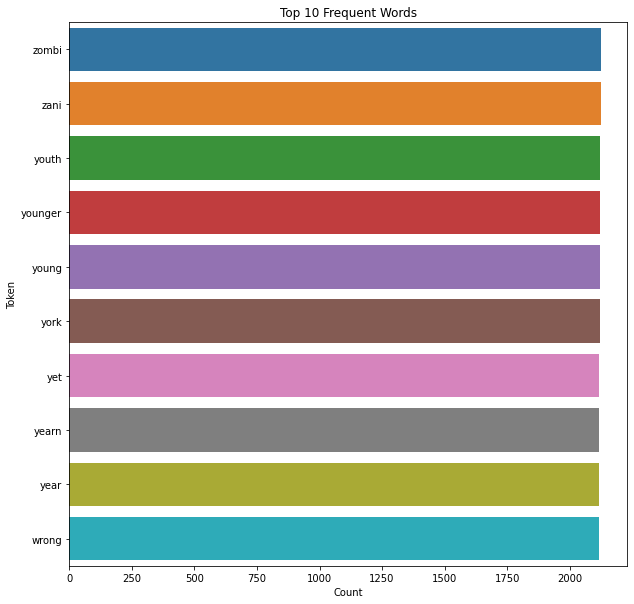

In [294]:
plt.figure(figsize = (10,10))
plt.title('Top 10 Frequent Words')
data = count_description_df.sort_values('Count', ascending = False).head(10)
sns.barplot(y = data.index, x = data['Count'])


### TF-IDF

**DESCRIPTION**

In [703]:
# terms should occur at least in five documents and shouldn't repeat more than 70% of the times
tfidf_description_vectorizer = TfidfVectorizer(ngram_range = (1,2), min_df= 10,max_df = 0.7)
# fit the count vectorizer using the text data
tfidf_description_vectorizer.fit(df['Processed Description'])

#converting processed text into tfidf vector
tfidf_description_vector = tfidf_description_vectorizer.transform(df['Processed Description'])
# Collect the vocabulary items used in the vectorizer
dictionary = tfidf_description_vectorizer.vocabulary_.items()


In [704]:
tfidf_description_vector.shape

(7787, 2362)

In [705]:
# Lists to store the vocab and counts
vocab = []
count_of_vocab = []
# Iterate through each vocab and count append the value to designated lists
for key, value in dictionary:
    vocab.append(key)
    count_of_vocab.append(value)

tfidf_description_df = pd.DataFrame({'Token':vocab, 'TFIDF':np.array(count_of_vocab)})
tfidf_description_df.set_index('Token',inplace = True)

**GNERE DETAILS**

In [706]:
# terms should occur at least in five documents and shouldn't repeat more than 70% of the times
# extracting single words, bi-grams and tri-grams
tfidf_movie_vectorizer = TfidfVectorizer(ngram_range = (1,1), min_df = 3)
# fit the count vectorizer ung the text data
tfidf_movie_vectorizer.fit(df['Movie Deets'])

#converting processed text into tfidf vector
tfidf_movie_vector = tfidf_movie_vectorizer.transform(df['Movie Deets'])
# Collect the vocabulary items used in the vectorizer
dictionary = tfidf_movie_vectorizer.vocabulary_.items()


In [707]:
tfidf_movie_vector.shape

(7787, 3159)

In [ ]:
vocab = []
count_of_vocab = []
# Iterate through each vocab and count append the value to designated lists
for key, value in dictionary:
    vocab.append(key)
    count_of_vocab.append(value)

tfidf_movie_df = pd.DataFrame({'Token':vocab, 'TFIDF':np.array(count_of_vocab)})
tfidf_movie_df.set_index('Token',inplace = True)

# Preparing dataset for clustering

In [260]:
clustering_df = df[['type', 'duration','rating','release_year']]

###ENCODING TYPE, RATING

In [261]:
clustering_df = pd.concat([clustering_df.drop(['type','rating'],axis =1), pd.get_dummies(clustering_df['rating']).drop('unknown',axis=1), pd.get_dummies(clustering_df['type'])], axis =1)

###PROCESSING MOVIE DURATION

In [262]:
def duration(row,column):
  text = row['duration'].split()
  if column == 'show':
    if row['Movie'] == 0:
      return int(text[0])
    else:
      return 0
  if column == 'movie':
    if row['Movie'] ==1:
      return int(text[0])
    else:
      return 0
clustering_df['show_duration'] = clustering_df.apply(lambda x: duration(x,'show'),axis =1)

clustering_df['movie_duration'] = clustering_df.apply(lambda x: duration(x,'movie'), axis=1)

In [263]:
clustering_df.drop('duration', axis = 1, inplace=True)

In [264]:
clustering_df

,release_year,G,NC-17,NR,PG,PG-13,R,TV-14,TV-G,TV-MA,TV-PG,TV-Y,TV-Y7,TV-Y7-FV,UR,Movie,TV Show,show_duration,movie_duration
0,2020,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,4,0
1,2016,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,93
2,2011,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,78
3,2009,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,80
4,2008,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7782,2005,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,99
7783,2015,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,111
7784,2019,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,44
7785,2019,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0


#Clustering without text insights

Here, clustering is performed based on the ratings, release year, show duration  and type of the content. This is essentially a very basic clustering as the data fed inside does not include any details regarding the plot, actors and cast involved.

In [265]:
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import linear_kernel
from sklearn.preprocessing import StandardScaler


import matplotlib.cm as cm
from sklearn import metrics
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


from sklearn.cluster import KMeans , AgglomerativeClustering, DBSCAN
from sklearn.cluster import AffinityPropagation
from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder



In [266]:

stdscaler = StandardScaler()
X_rescale = stdscaler.fit_transform(clustering_df)
X = (X_rescale)

###Performing Hopkins test for uniform distribution to check if clustering is possible on the dataset

In [267]:
pip install pyclustertend

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [268]:
from pyclustertend import hopkins
hopkins(X,150)

0.001476386287485832

---
>* **The result is very close to zero and less than 0.3. This data set qualifies for clustering**
---



#**DBSCAN**
DBSCAN stands for Density-Based Spatial Clustering of Applications with Noise.It groups ‘densely grouped’ data points into a single cluster. It can identify clusters in large spatial datasets by looking at the local density of the data points. The most exciting feature of DBSCAN clustering is that it is robust to outliers. It also does not require the number of clusters to be told beforehand, unlike K-Means, where we have to specify the number of centroids.

DBSCAN requires only two parameters: epsilon and minPoints. Epsilon is the radius of the circle to be created around each data point to check the density and minPoints is the minimum number of data points required inside that circle for that data point to be classified as a Core point.

In [269]:
dbscan = DBSCAN().fit(X)
preds = dbscan.labels_

In [270]:
silhouette_score(X,preds)

0.6553454526180158

In [271]:
pd.Series(preds).nunique()

52

**VISUALIZATION**

In [272]:
predictions = pd.DataFrame(preds, columns = ['Labels'])

In [273]:
# Dimensionality reduction using PCA
pca = PCA(n_components = 3)

In [274]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
hier_cluster = pd.concat([reduced, predictions], axis=1)

In [275]:
colors = ['#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff']


In [276]:
sns.color_palette(colors)

[(0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0),
 (0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0),
 (0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0)]

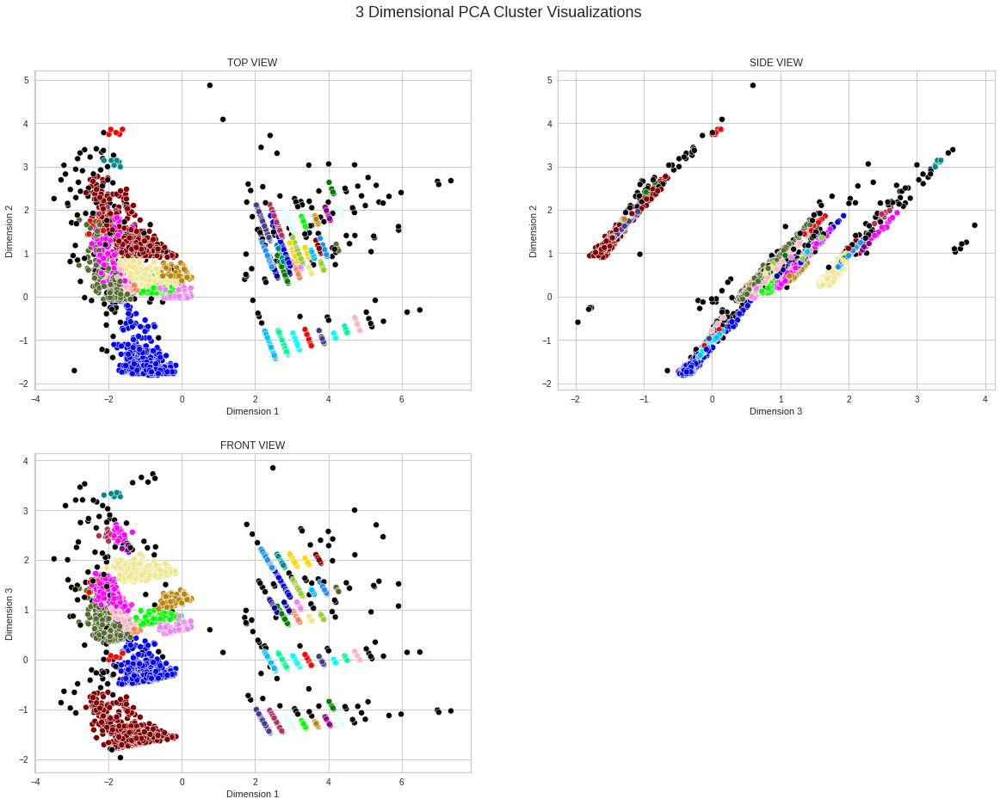

In [277]:
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:52]), legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2',  data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:52]), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:52]), legend=False)


#**K-MEANS**
It is an iterative algorithm that divides the unlabeled dataset into k different clusters in such a way that each dataset belongs only one group that has similar propert

**Implementing K-means clustering and calculating the Silhouette scores for clusters of 2 to 25 for content based on Release Year, Ratings, Type and Duration**

A silhouette score of 1 means that the clusters are very dense and nicely separated. The score of 0 means that clusters are overlapping. The score of less than 0 means that data belonging to clusters may be wrong/incorrect. The silhouette plots can be used to select the most optimal value of the K 

In [278]:
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score

In [279]:
silhouette_score_ = [ ]
range_n_clusters = [i for i in range(2,26)]
for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters, n_init=10,random_state=10)
    preds = clusterer.fit_predict(X)
    centers = clusterer.cluster_centers_

    score = silhouette_score(X, preds)
    silhouette_score_.append([int(n_clusters) , round(score , 3)])

In [280]:
Kmeans = pd.DataFrame(silhouette_score_ , columns = ["No of Clusters" , "Silhouette Score"])
Kmeans = Kmeans.sort_values( "Silhouette Score" , ascending = False )
Kmeans

,No of Clusters,Silhouette Score
22,24,0.730
21,23,0.730
20,22,0.730
19,21,0.728
18,20,0.723
17,19,0.719
23,25,0.716
16,18,0.707
15,17,0.692
14,16,0.660


####**OBSERVATIONS**
---
> * **The highest silhouette scored is produced with 24 Clusters**
> * **We can also observe that there isn't any large improvements in increasing cluster numbers over 17 with raise in performance less than 0.1**
---

## **Using Elbow Method to determine the Optimal number of Clusters**

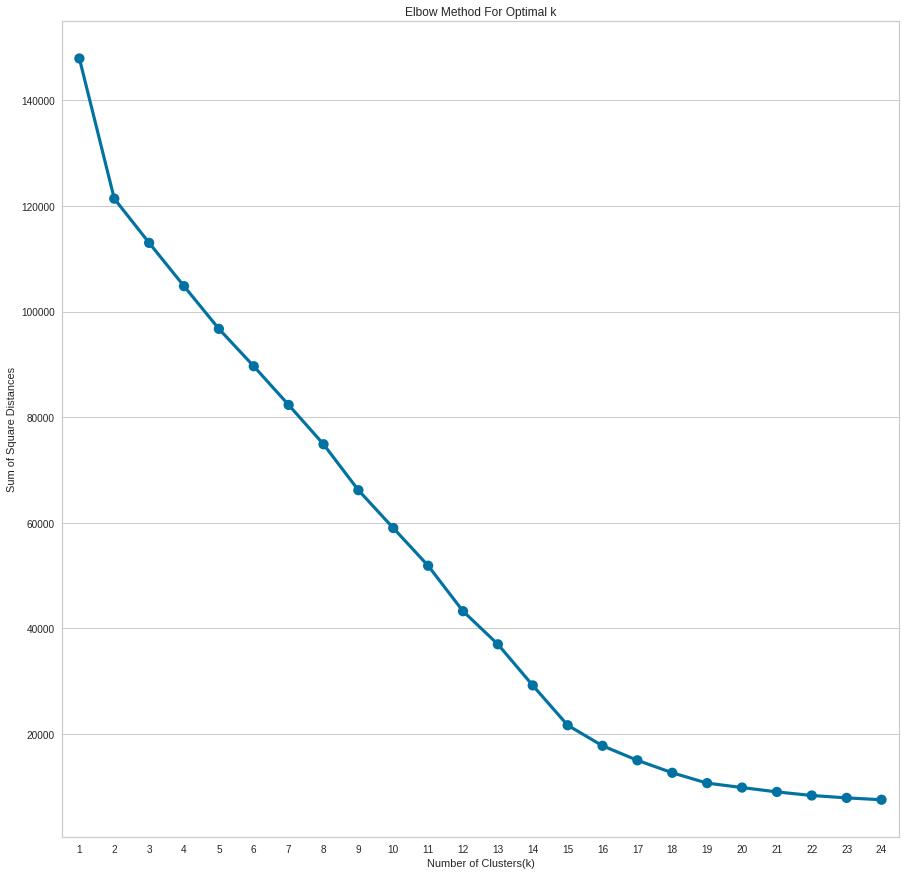

In [281]:
sum_of_sq_dist = {}
for k in range(1,25):
    km = KMeans(n_clusters= k, init= 'k-means++', max_iter= 1000, random_state=10)
    km = km.fit(X)
    sum_of_sq_dist[k] = km.inertia_
    
#Plot the graph for the sum of square distance values and Number of Clusters
plt.figure(figsize=(15,15))
sns.pointplot(x = list(sum_of_sq_dist.keys()), y = list(sum_of_sq_dist.values()))
plt.xlabel('Number of Clusters(k)')
plt.ylabel('Sum of Square Distances')
plt.title('Elbow Method For Optimal k')
plt.show()

####**OBSERVATIONS**
---
> **From the above graph, 17 clusters can be observed to be the optimum amount of clusters**

> **After 17 clusters the change in sum square distance is very nominal**
---



## **Displaying Silhouette plot for K means Clustering**

For n_clusters = 2 The average silhouette_score is : 0.29369279440195906
For n_clusters = 3 The average silhouette_score is : 0.2741846134372296
For n_clusters = 4 The average silhouette_score is : 0.3237421565409504
For n_clusters = 5 The average silhouette_score is : 0.3606171442555342
For n_clusters = 6 The average silhouette_score is : 0.4025586914249655
For n_clusters = 7 The average silhouette_score is : 0.3133796338924812
For n_clusters = 8 The average silhouette_score is : 0.46956879456109885
For n_clusters = 9 The average silhouette_score is : 0.4203669597783468
For n_clusters = 10 The average silhouette_score is : 0.4799916191132543
For n_clusters = 11 The average silhouette_score is : 0.48673177170528986
For n_clusters = 12 The average silhouette_score is : 0.4656625344079436
For n_clusters = 13 The average silhouette_score is : 0.5749112913442177
For n_clusters = 14 The average silhouette_score is : 0.5761146571001393
For n_clusters = 15 The average silhouette_score is : 0.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 22 The average silhouette_score is : 0.730069400927405


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 23 The average silhouette_score is : 0.7299569947330279


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 24 The average silhouette_score is : 0.7304983722259607


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 25 The average silhouette_score is : 0.7164175465166565


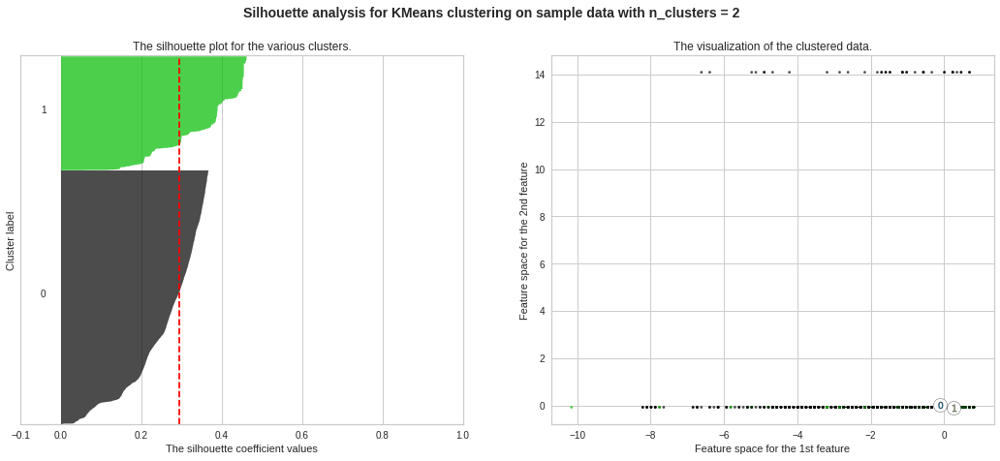

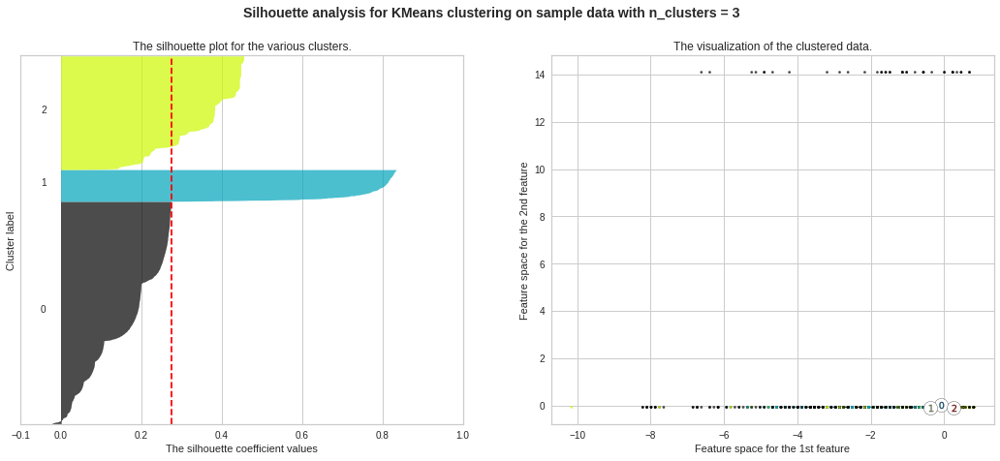

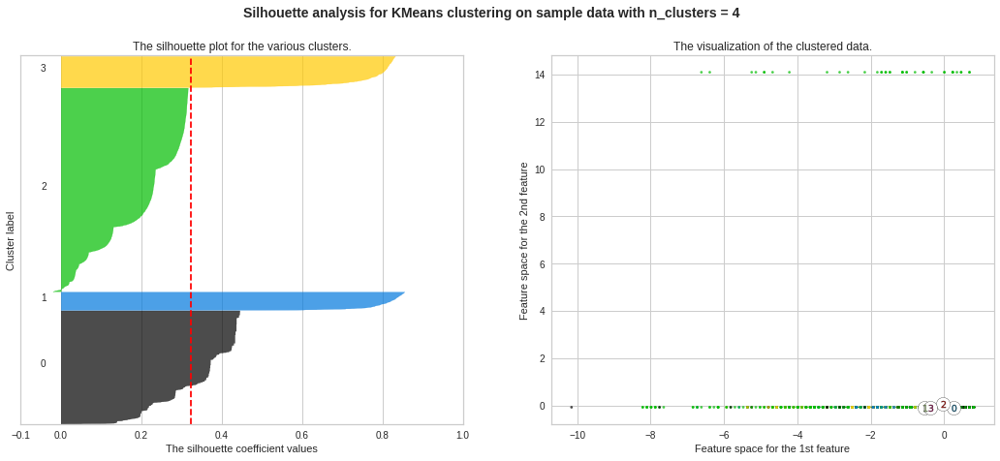

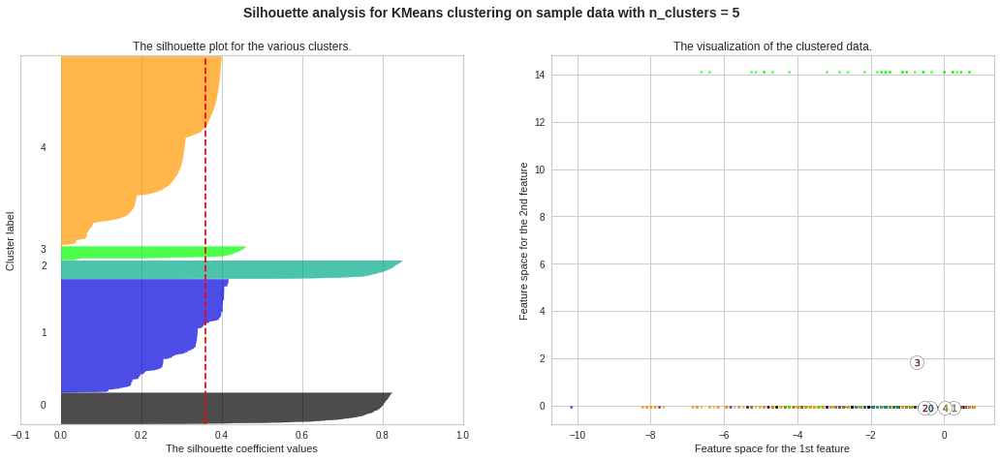

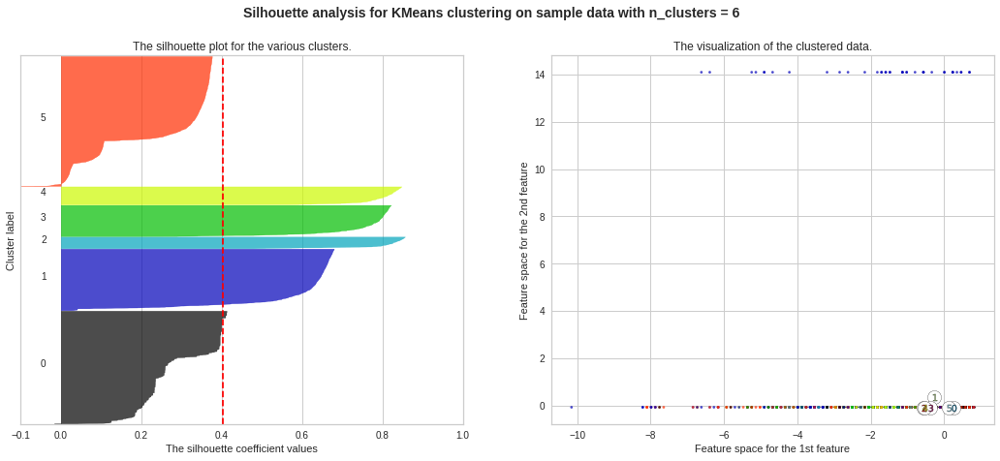

...

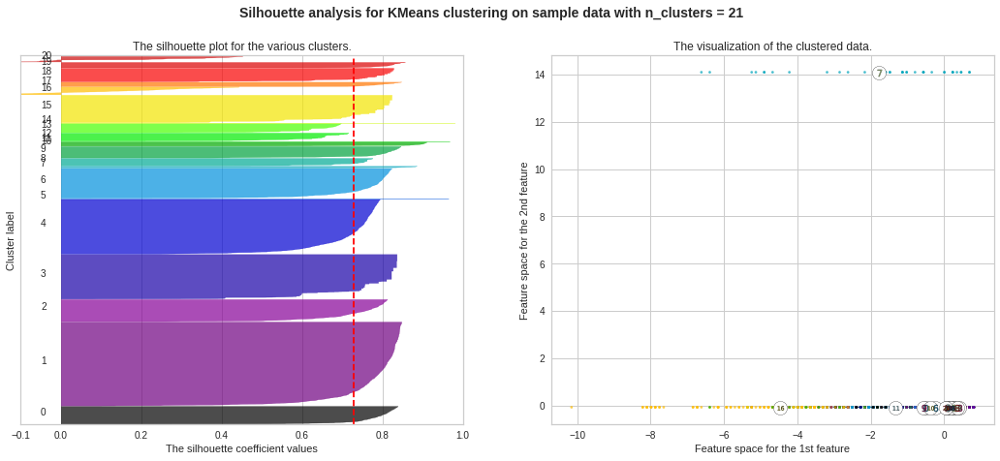

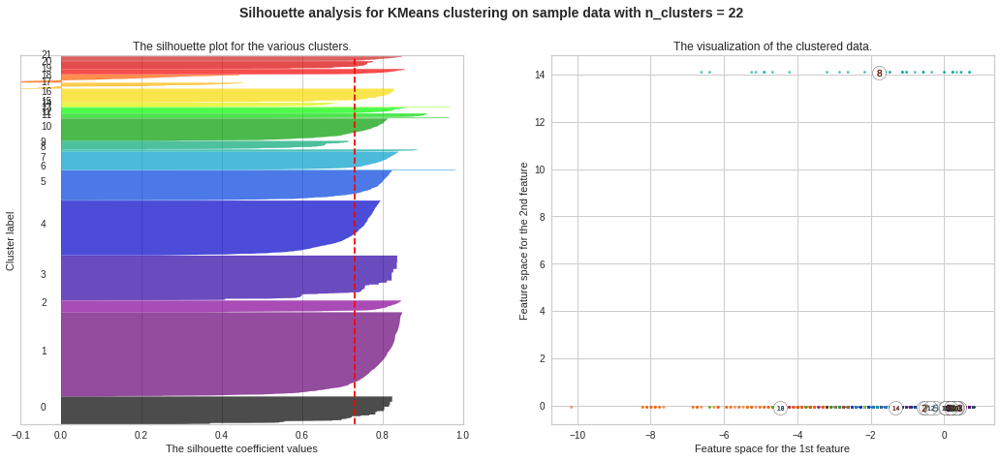

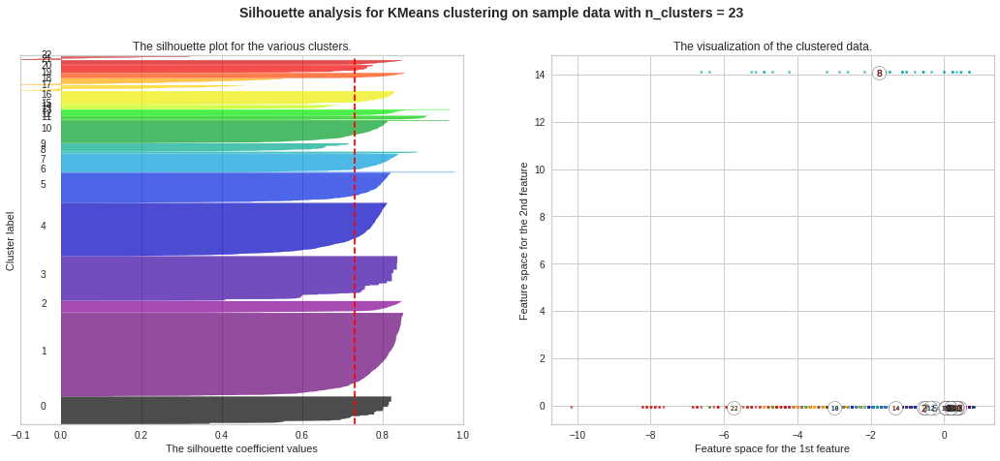

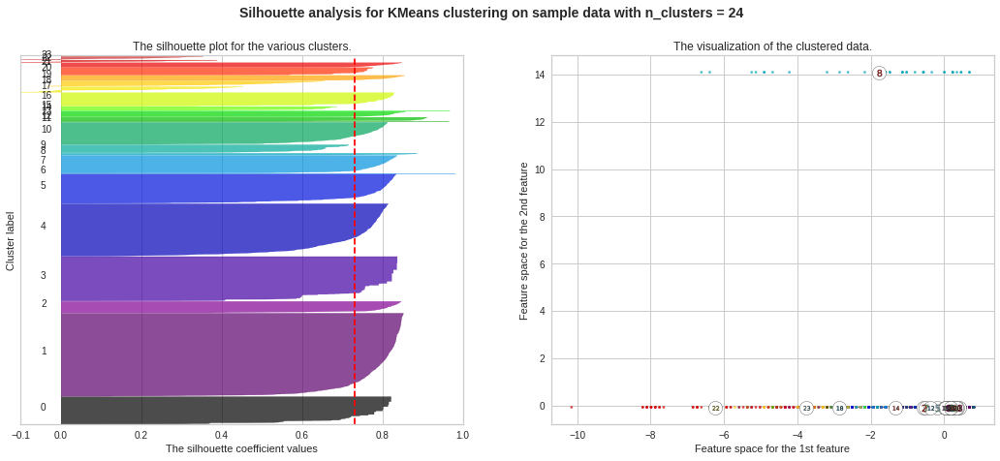

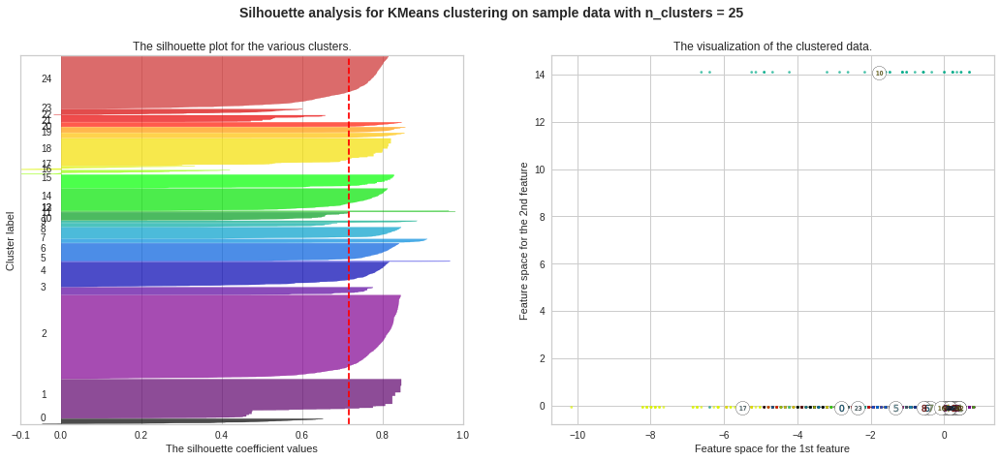

In [282]:
range_n_clusters = [i for i in range(2,26)]
silhouette_score_ = []
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) /n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")
    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

**OBSERVATION**

> **Displayed below is the silhouette plot for 17 Clusters formed using K-Means Algorithm producing silhouette score of 0.692**


**SILHOUETTE PLOT IMAGE**

---
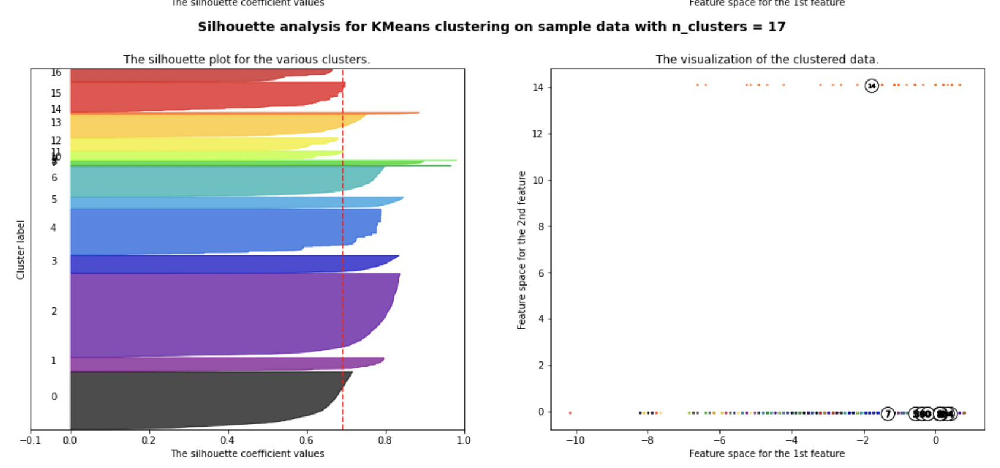

## **Visualisation of K means using PCA**



In [283]:
clusterer = KMeans(n_clusters= 17, n_init=10,random_state=10)
preds = clusterer.fit_predict(X)

In [284]:
predictions = pd.DataFrame(preds, columns = ['Clusters'])

In [285]:
# Dimensionality reduction using PCA
from sklearn.decomposition import PCA
pca = PCA(n_components = 3)


In [286]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
kmeans_cluster = pd.concat([reduced, predictions], axis=1)

In [287]:
gyr = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', 
       '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324',
       '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075']
sns.color_palette(gyr)

[(0.9019607843137255, 0.09803921568627451, 0.29411764705882354),
 (0.23529411764705882, 0.7058823529411765, 0.29411764705882354),
 (1.0, 0.8823529411764706, 0.09803921568627451),
 (0.2627450980392157, 0.38823529411764707, 0.8470588235294118),
 (0.9607843137254902, 0.5098039215686274, 0.19215686274509805),
 (0.5686274509803921, 0.11764705882352941, 0.7058823529411765),
 (0.9411764705882353, 0.19607843137254902, 0.9019607843137255),
 (0.7372549019607844, 0.9647058823529412, 0.047058823529411764),
 (0.9803921568627451, 0.7450980392156863, 0.7450980392156863),
 (0.0, 0.5019607843137255, 0.5019607843137255),
 (0.9019607843137255, 0.7450980392156863, 1.0),
 (0.6039215686274509, 0.38823529411764707, 0.1411764705882353),
 (0.5019607843137255, 0.0, 0.0),
 (0.6666666666666666, 1.0, 0.7647058823529411),
 (0.5019607843137255, 0.5019607843137255, 0.0),
 (1.0, 0.8470588235294118, 0.6941176470588235),
 (0.0, 0.0, 0.4588235294117647)]

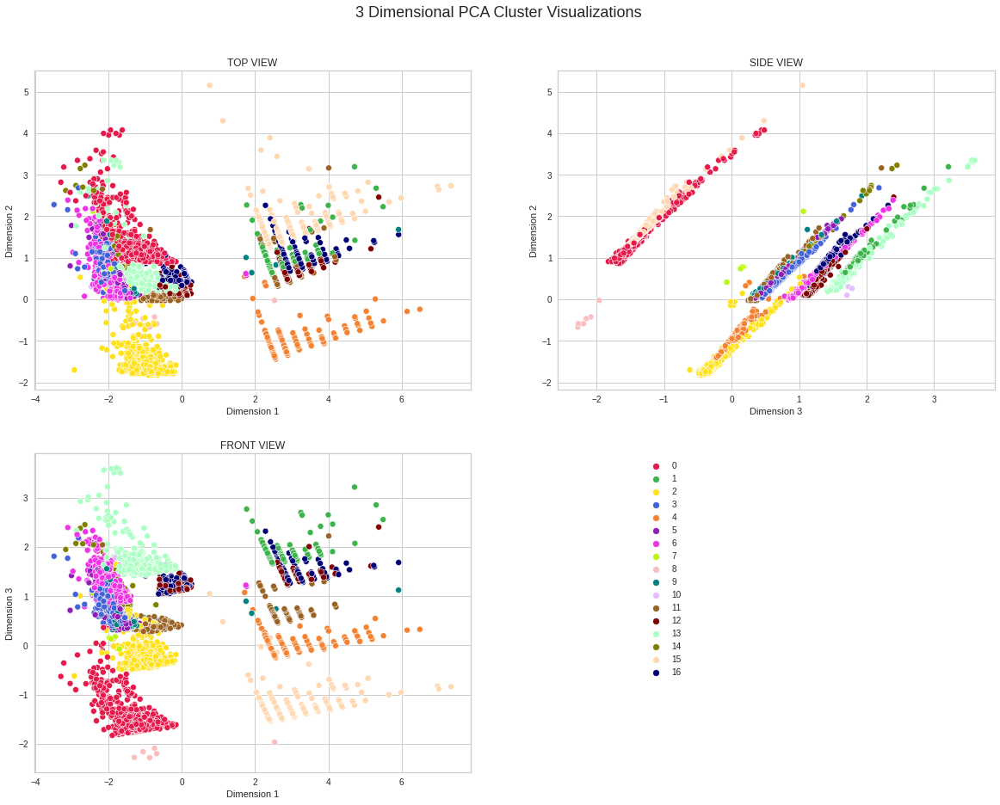

In [288]:
from matplotlib import transforms
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr), legend=False
                )

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr))
plt.legend(bbox_to_anchor=(1.5,1))


# **HIERARCHICAL CLUSTERING**

Hierarchical clustering, also known as hierarchical cluster analysis, is an algorithm that groups similar objects into groups called clusters. The endpoint is a set of clusters, where each cluster is distinct from each other cluster, and the objects within each cluster are broadly similar to each other.


In [289]:
# Let's import sch
import scipy.cluster.hierarchy as sch
hier_ward_euc = sch.linkage(X, method = 'ward', metric = 'euclidean')

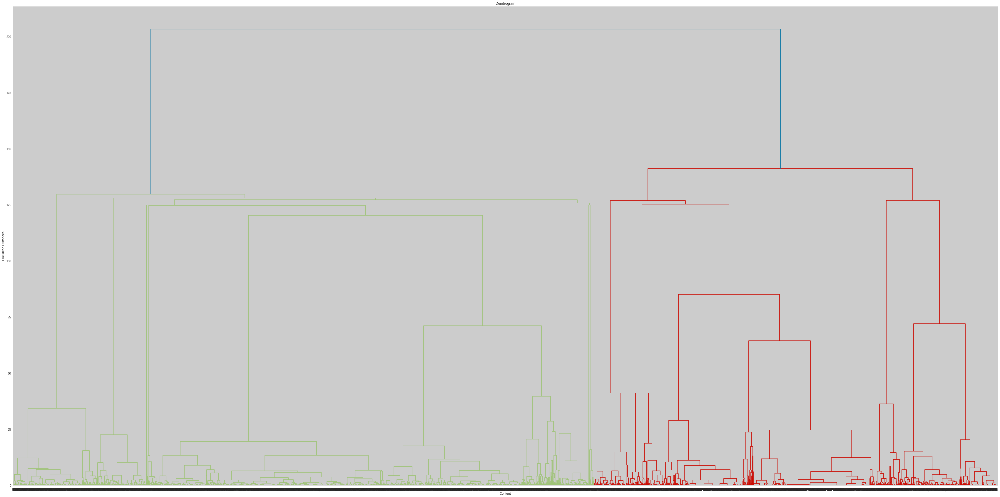

In [290]:
plt.figure(figsize=(60,30))
dendrogram = sch.dendrogram(hier_ward_euc)
plt.title('Dendrogram')
plt.xlabel('Content')
plt.ylabel('Euclidean Distances')
plt.show() # find largest vertical distance we can make without crossing any other horizontal line


###Agglomerative Clustering

In [291]:
#Importing AgglomerativeClustering
from sklearn.cluster import AgglomerativeClustering


In [292]:
clusters = []
scores = []
distances = []
for i in np.arange(10,200,20):
  hc = AgglomerativeClustering(n_clusters = None, distance_threshold = i, affinity = 'euclidean', linkage = 'ward')
  y_hc = hc.fit_predict(X)
  clusters.append(hc.labels_.max()+1)
  scores.append(silhouette_score(X, y_hc))
  distances.append(i)

hierarchical = pd.DataFrame({'Clusters': clusters, 
                             'Silhouette Scores': scores,
                             'Distance': distances})

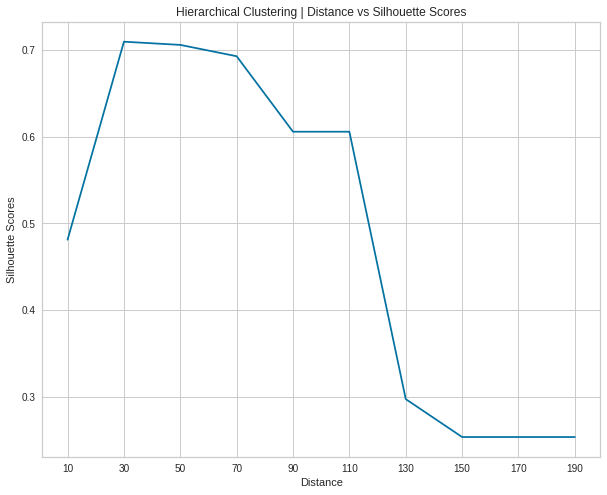

In [293]:
plt.figure(figsize =(10,8))
sns.lineplot(x = 'Distance', y = 'Silhouette Scores' , data = hierarchical)
a = plt.title('Hierarchical Clustering | Distance vs Silhouette Scores')
_ = plt.xticks(np.arange(10,200,20))

**Distance-Silhouette Score-Clusters Table for Hierarchical Clustering**

In [294]:
hierarchical.sort_values('Silhouette Scores', ascending = False).head(5)

,Clusters,Silhouette Scores,Distance
1,24,0.709740,30
2,19,0.706028,50
3,18,0.692934,70
4,15,0.605797,90
5,15,0.605797,110


#### **OBSERVATIONS**
---
> * **Optimal Distance observed near 30 for Hierarchical Clustering with Silhouette Score of 0.709**
> * **Has 24 Clusters for Optimal Hierarchical Clustering**
---

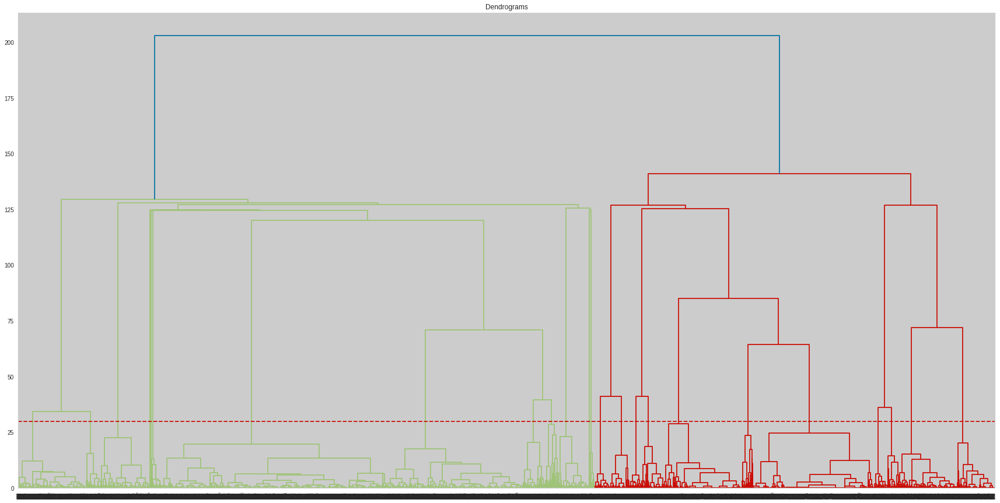

In [295]:
plt.figure(figsize =(30,15))
plt.title("Dendrograms")  
dend = sch.dendrogram(sch.linkage(X, method='ward'))
plt.axhline(y= 30, color='r', linestyle='--')

###**Visualisation of Clusters for Hierarchical Clustering**

In [296]:
hc = AgglomerativeClustering(n_clusters = None, distance_threshold = 30, affinity = 'euclidean', linkage = 'ward')
preds = hc.fit_predict(X)

In [297]:
 predictions = pd.DataFrame(preds, columns = ['Labels'])

In [298]:
# Dimensionality reduction using PCA
pca = PCA(n_components = 3)

In [299]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
hier_cluster = pd.concat([reduced, predictions], axis=1)

In [300]:
colors = ['#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff']


In [301]:
sns.color_palette(colors)

[(0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0)]

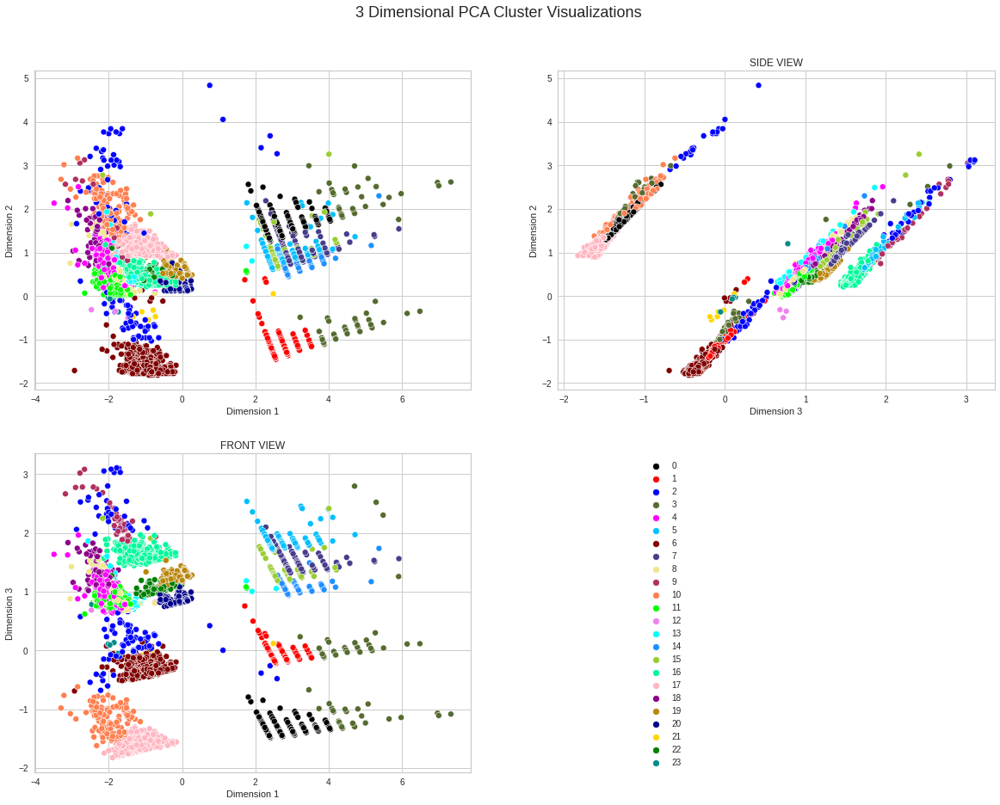

In [302]:
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)
plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:24]), legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2',  data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:24]), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:24]), legend=True)
_ = plt.legend(bbox_to_anchor=(1.5,1))


#CLUSTERING with TOPIC MODEL of Description and Genre 

##TOPIC MODELING using GENSIM 

In [303]:
topic_input = df['Processed Description'] + ' ' + (df['Genres']).apply(lambda x:' '.join(x))

In [304]:
from gensim.corpora import Dictionary

gensim_paragraphs = (topic_input).apply(lambda row: row.split(' '))
dict_gensim_para = Dictionary(gensim_paragraphs)
dict_gensim_para.filter_extremes(no_below=10)

bow_gensim_para = [dict_gensim_para.doc2bow(paragraph) for paragraph in gensim_paragraphs]


In [305]:
from gensim.models import TfidfModel
tfidf_gensim_para = TfidfModel(bow_gensim_para)
vectors_gensim_para = tfidf_gensim_para[bow_gensim_para]

In [306]:
from gensim.models.ldamulticore import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel

In [307]:

lda_para_model_n = []
for n in (range(5, 21)):
  lda_model = LdaMulticore(corpus=bow_gensim_para, id2word=dict_gensim_para,
                            chunksize=2000, eta='auto', iterations=400,
                            num_topics=n, passes=20, eval_every=None,
                            random_state=42)
  lda_coherence = CoherenceModel(model=lda_model, texts=gensim_paragraphs,
                            dictionary=dict_gensim_para, coherence='c_v')
  print(n,'|', lda_coherence.get_coherence())
  lda_para_model_n.append((n, lda_model, lda_coherence.get_coherence()))

5 | 0.3415179596593296
6 | 0.34750795486657604
7 | 0.34771785469642097
8 | 0.31072422701502683
9 | 0.3707009700929223
10 | 0.36939614318412184
11 | 0.35557879029850237
12 | 0.38344147230315295
13 | 0.36618694405457375
14 | 0.33236713008545615
15 | 0.3833031515231985
16 | 0.37638400569694175
17 | 0.3569637984462508
18 | 0.3744619465068514
19 | 0.34333898681949915
20 | 0.3604975976171781


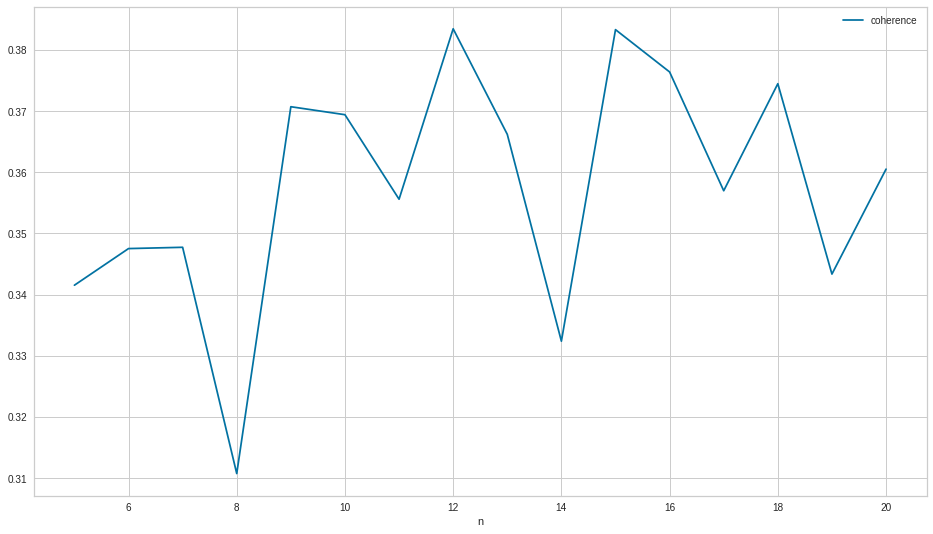

In [308]:
pd.DataFrame(lda_para_model_n, columns=["n", "model", \
"coherence"]).set_index("n")[["coherence"]].plot(figsize=(16,9))

**8 Topics have the highest coherence score**

In [310]:
lda_gensim_para = LdaMulticore(corpus=bow_gensim_para, id2word=dict_gensim_para,
                            chunksize=2000, eta='auto', iterations=400,
                            num_topics=12, passes=20, eval_every=None,
                            random_state=42)

In [311]:
def display_gensim_topics(model):
  gen_list = lda_gensim_para.print_topics()
  for i in range(0,len(gen_list)):
    print('Topic: ',i+1,'\n')
    topics = gen_list[i][1]
    for j in topics.split('+'):
      print(j.split('"')[1])

    print("------\n")

display_gensim_topics(lda_gensim_para)

Topic:  1 

Drama
Thriller
Crime
Horror
murder
crime
investig
mysteri
detect
young
------

Topic:  2 

Drama
Documentary
stori
base
life
true
film
event
seri
drama
------

Topic:  3 

Comedy
Romance
Drama
love
friend
get
year
meet
find
two
------

Topic:  4 

Documentary
documentari
examin
Crime
seri
suspect
explor
serial
world
life
------

Topic:  5 

Drama
town
Comedy
small
life
young
Romance
find
new
love
------

Topic:  6 

Drama
school
Comedy
high
student
life
new
colleg
teen
dream
------

Topic:  7 

ActionAdventure
SciFiFantasy
power
forc
war
fight
Drama
agent
Anime
mission
------

Topic:  8 

Documentary
Music
documentari
behind
music
histori
band
film
Horror
scene
------

Topic:  9 

Comedy
comedi
stand
special
comedian
show
take
comic
stage
live
------

Topic:  10 

Documentary
Reality
Sports
world
competit
team
win
player
show
chef
------

Topic:  11 

Kids
Family
friend
adventur
anim
world
new
magic
Comedy
help
------

Topic:  12 

Drama
young
famili
Comedy
man
love
Romance

In [312]:
lda = {}
for i in range(0,lda_gensim_para.num_topics):
  lda[f'Topic {i}'] = np.zeros(df.shape[0])

In [313]:
for i, row in enumerate(lda_gensim_para[bow_gensim_para]):
  for topic in row:
    lda[f'Topic {topic[0]}'][i] = topic[1] 


In [314]:
topic_model_df = pd.DataFrame(lda)

In [315]:
topic_model_df

,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11
0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.616022,0.000000,0.079925,0.000000,0.257176,0.000000
1,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.214441,0.360838,0.000000,0.000000,0.000000,0.377845
2,0.474071,0.000000,0.0,0.000000,0.000000,0.000000,0.367967,0.000000,0.000000,0.000000,0.113844,0.000000
3,0.115627,0.091679,0.0,0.191787,0.000000,0.000000,0.549623,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.0,0.378755,0.156577,0.406975,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
7782,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.241490,0.000000,0.000000,0.000000,0.000000,0.682750
7783,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.244791,0.000000,0.000000,0.000000,0.695684
7784,0.000000,0.125577,0.0,0.000000,0.000000,0.000000,0.000000,0.340063,0.151471,0.343673,0.000000,0.000000
7785,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.131864,0.000000,0.000000,0.804032,0.000000,0.000000


##SCALING

###Concatenating clustering_df with topic models

In [316]:
clustering_df

,release_year,G,NC-17,NR,PG,PG-13,R,TV-14,TV-G,TV-MA,TV-PG,TV-Y,TV-Y7,TV-Y7-FV,UR,Movie,TV Show,show_duration,movie_duration
0,2020,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,4,0
1,2016,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,93
2,2011,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,78
3,2009,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,80
4,2008,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,123
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7782,2005,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,99
7783,2015,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,111
7784,2019,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,44
7785,2019,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0


In [317]:
vectorizer_clustering = pd.concat([clustering_df ,pd.DataFrame(topic_model_df)], axis =1)

In [318]:
stdscaler = StandardScaler()
X_rescale = stdscaler.fit_transform(vectorizer_clustering)
X = (X_rescale)

###Performing Hopkins test for uniform distribution to check if clustering is possible on the dataset

In [319]:
from pyclustertend import hopkins
hopkins(X,150)

0.0345760746373477

In [320]:
X.shape

(7787, 31)

#**DBSCAN**
DBSCAN stands for Density-Based Spatial Clustering of Applications with Noise.It groups ‘densely grouped’ data points into a single cluster. It can identify clusters in large spatial datasets by looking at the local density of the data points. The most exciting feature of DBSCAN clustering is that it is robust to outliers. It also does not require the number of clusters to be told beforehand, unlike K-Means, where we have to specify the number of centroids.

DBSCAN requires only two parameters: epsilon and minPoints. Epsilon is the radius of the circle to be created around each data point to check the density and minPoints is the minimum number of data points required inside that circle for that data point to be classified as a Core point.

In [321]:
dbscan = DBSCAN().fit(X)
preds = dbscan.labels_

In [322]:
silhouette_score(X,preds)

-0.3848828817586255

In [323]:
pd.Series(preds).nunique()

53

**VISUALIZATION**

In [328]:
predictions = pd.DataFrame(preds, columns = ['Labels'])

In [329]:
# Dimensionality reduction using PCA
pca = PCA(n_components = 3)

In [330]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
hier_cluster = pd.concat([reduced, predictions], axis=1)

In [333]:
colors = ['#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff',
 '#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff'
]


In [334]:
sns.color_palette(colors)

[(0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0),
 (0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0),
 (0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0),
 (0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.545098

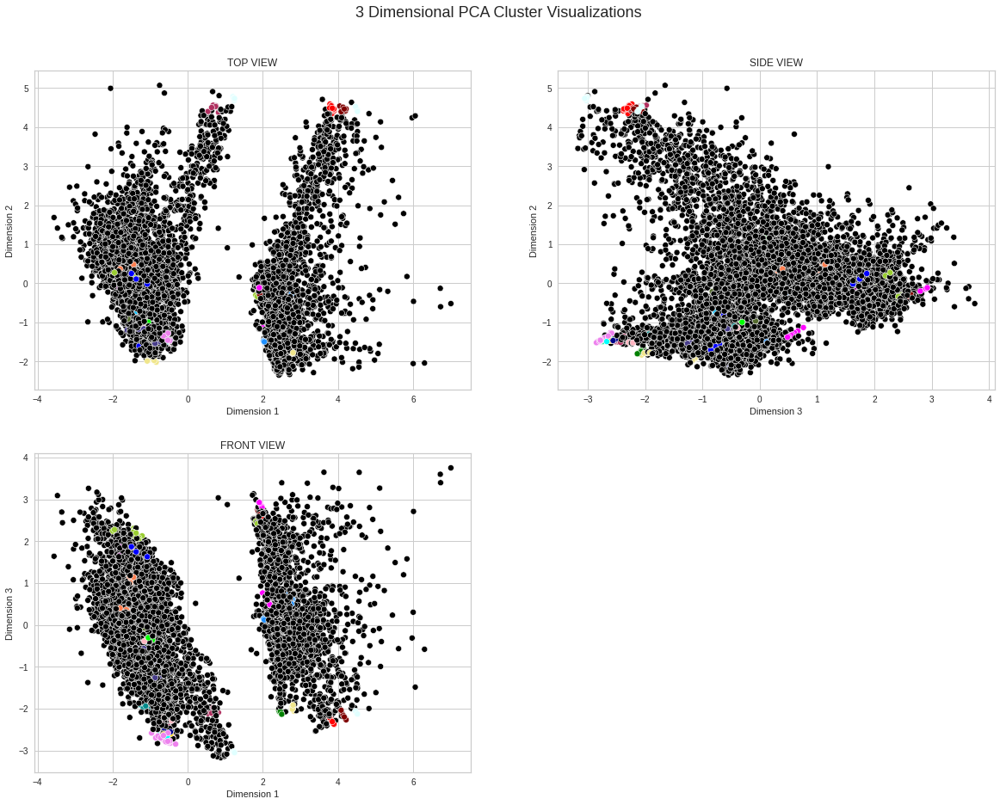

In [335]:
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:53]), legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2',  data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:53]), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:53]), legend=False)


#**K-MEANS**
It is an iterative algorithm that divides the unlabeled dataset into k different clusters in such a way that each dataset belongs only one group that has similar propert

**Implementing K-means clustering and calculating the Silhouette scores for clusters of 2 to 25 for content based on Release Year, Ratings, Type and Duration**

A silhouette score of 1 means that the clusters are very dense and nicely separated. The score of 0 means that clusters are overlapping. The score of less than 0 means that data belonging to clusters may be wrong/incorrect. The silhouette plots can be used to select the most optimal value of the K 

In [336]:
silhouette_score_ = [ ]
range_n_clusters = [i for i in range(2,26)]
for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters, n_init=10,random_state=10)
    preds = clusterer.fit_predict(X)
    centers = clusterer.cluster_centers_

    score = silhouette_score(X, preds)
    silhouette_score_.append([int(n_clusters) , round(score , 3)])

In [337]:
Kmeans = pd.DataFrame(silhouette_score_ , columns = ["No of Clusters" , "Silhouette Score"])
Kmeans = Kmeans.sort_values( "Silhouette Score" , ascending = False )
Kmeans.head()

,No of Clusters,Silhouette Score
16,18,0.227
17,19,0.220
20,22,0.216
15,17,0.215
22,24,0.213


####**OBSERVATIONS**
---
> * **The highest silhouette scored is 0.227 produced with 18 Clusters using K Means Algorithm**
---

## **Using Elbow Method to determine the Optimal number of Clusters**

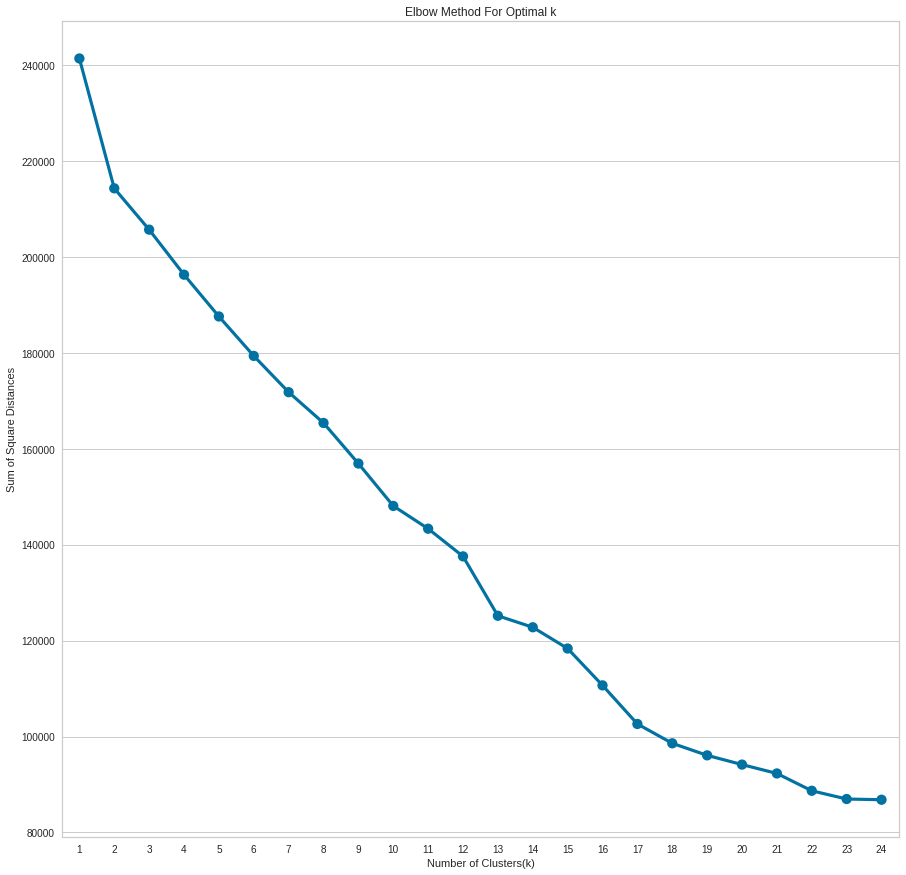

In [338]:
sum_of_sq_dist = {}
for k in range(1,25):
    km = KMeans(n_clusters= k, init= 'k-means++', max_iter= 1000, random_state=10)
    km = km.fit(X)
    sum_of_sq_dist[k] = km.inertia_
    
#Plot the graph for the sum of square distance values and Number of Clusters
plt.figure(figsize=(15,15))
sns.pointplot(x = list(sum_of_sq_dist.keys()), y = list(sum_of_sq_dist.values()))
plt.xlabel('Number of Clusters(k)')
plt.ylabel('Sum of Square Distances')
plt.title('Elbow Method For Optimal k')
plt.show()

####**OBSERVATIONS**
---
> **From the above graph, 18 clusters can be observed to be the optimum amount of clusters**

> **After 18 clusters the change in sum square distance is very nominal**
---



## **Displaying Silhouette plot for K means Clustering**

For n_clusters = 2 The average silhouette_score is : 0.14235432452522034
For n_clusters = 3 The average silhouette_score is : 0.13013926567482914
For n_clusters = 4 The average silhouette_score is : 0.12614900893353467
For n_clusters = 5 The average silhouette_score is : 0.1137201069033192
For n_clusters = 6 The average silhouette_score is : 0.14564765923544112
For n_clusters = 7 The average silhouette_score is : 0.17217841365232403
For n_clusters = 8 The average silhouette_score is : 0.17625789051994914
For n_clusters = 9 The average silhouette_score is : 0.14728756083685815
For n_clusters = 10 The average silhouette_score is : 0.173068842461335
For n_clusters = 11 The average silhouette_score is : 0.16973806497551908
For n_clusters = 12 The average silhouette_score is : 0.17264514114623172
For n_clusters = 13 The average silhouette_score is : 0.19019908368820646
For n_clusters = 14 The average silhouette_score is : 0.197217274837719
For n_clusters = 15 The average silhouette_score is

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 22 The average silhouette_score is : 0.2158648225011993


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 23 The average silhouette_score is : 0.2063578073053192


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 24 The average silhouette_score is : 0.21336080677674077


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


For n_clusters = 25 The average silhouette_score is : 0.2092565350363381


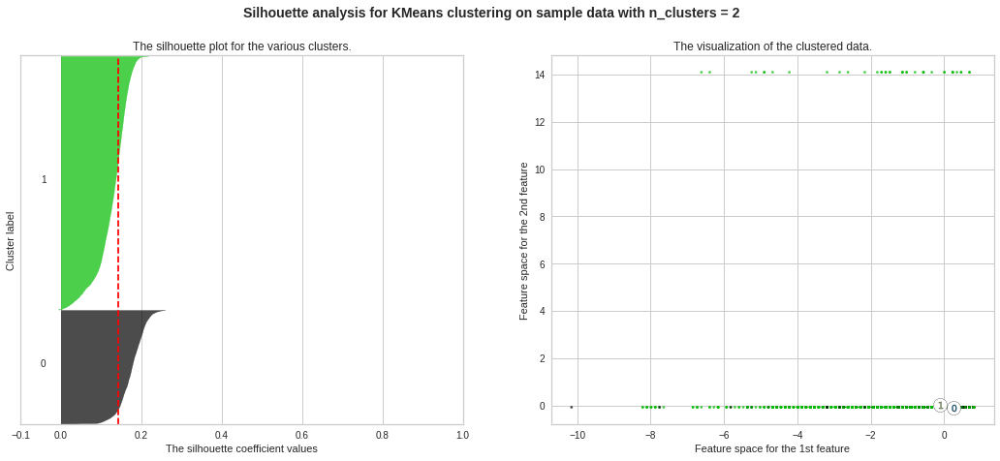

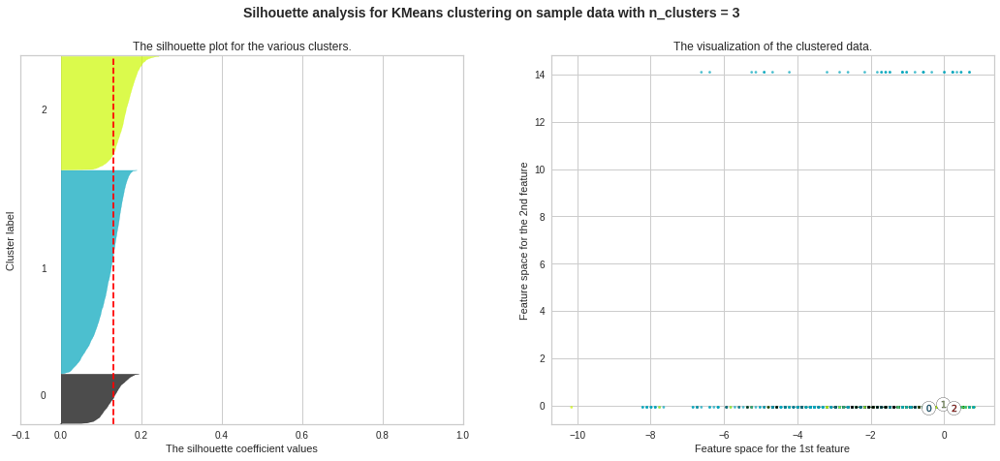

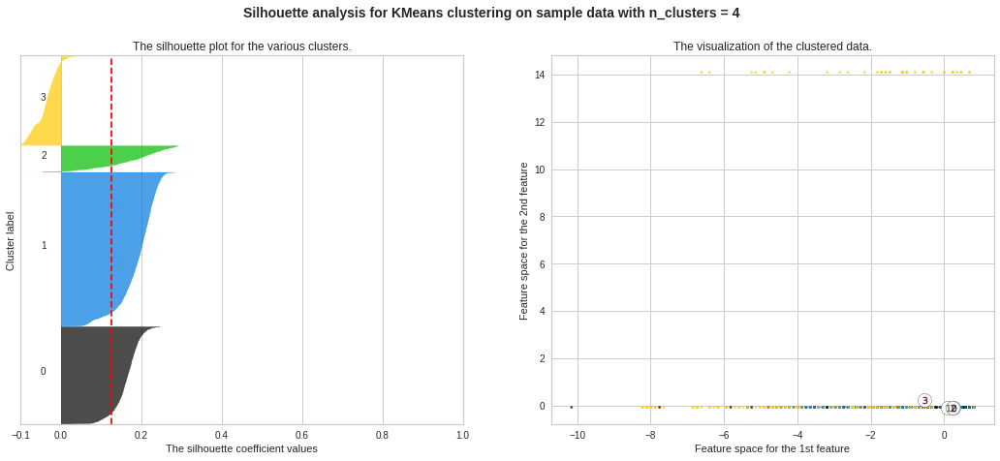

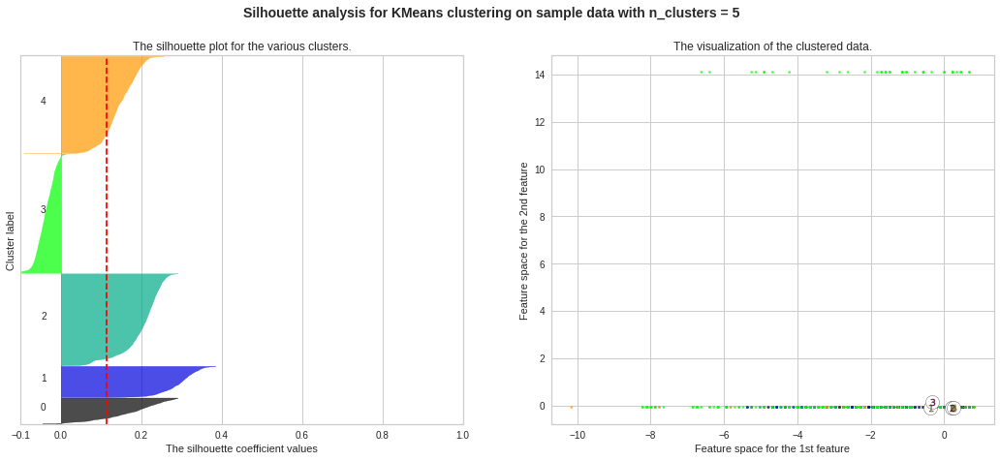

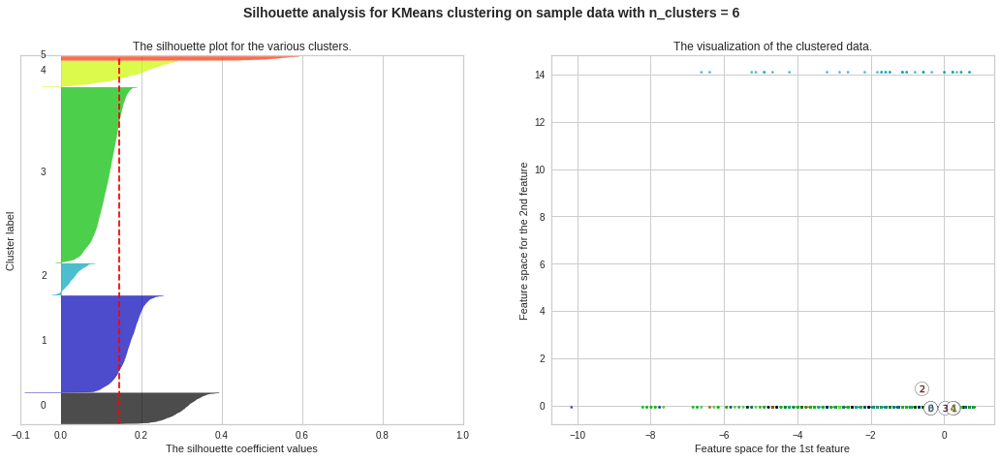

...

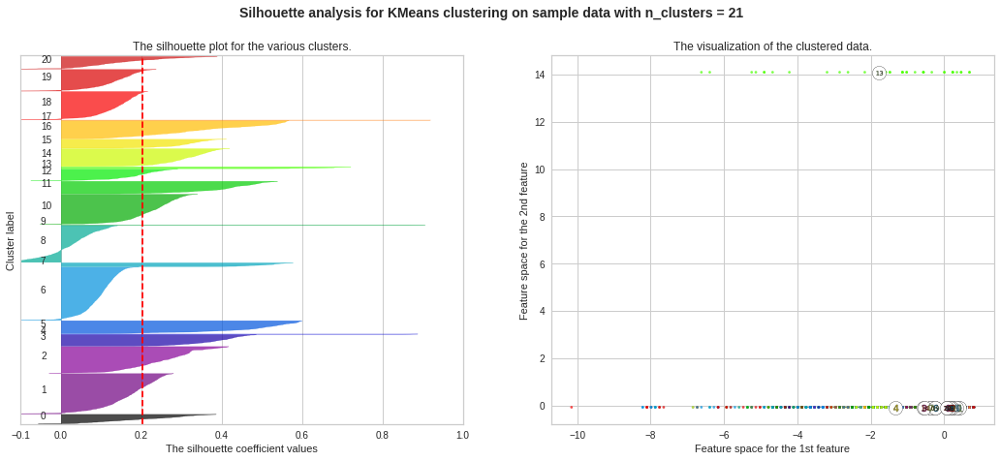

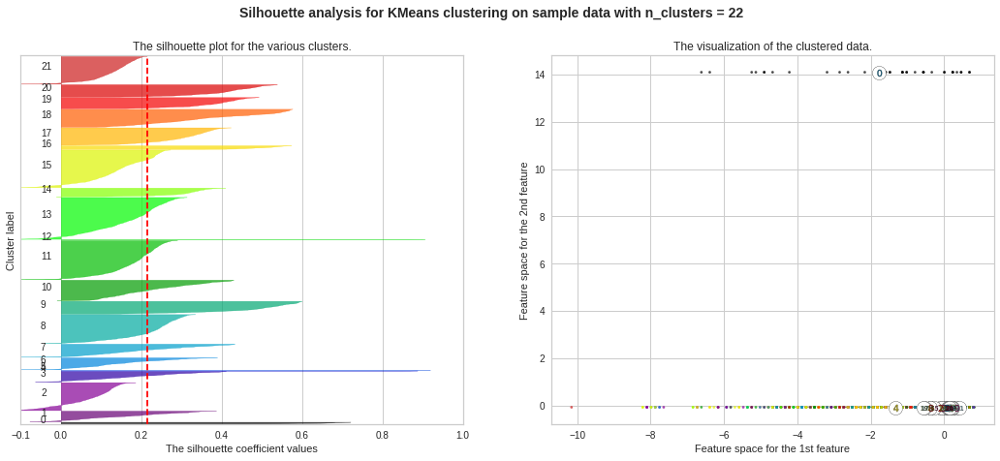

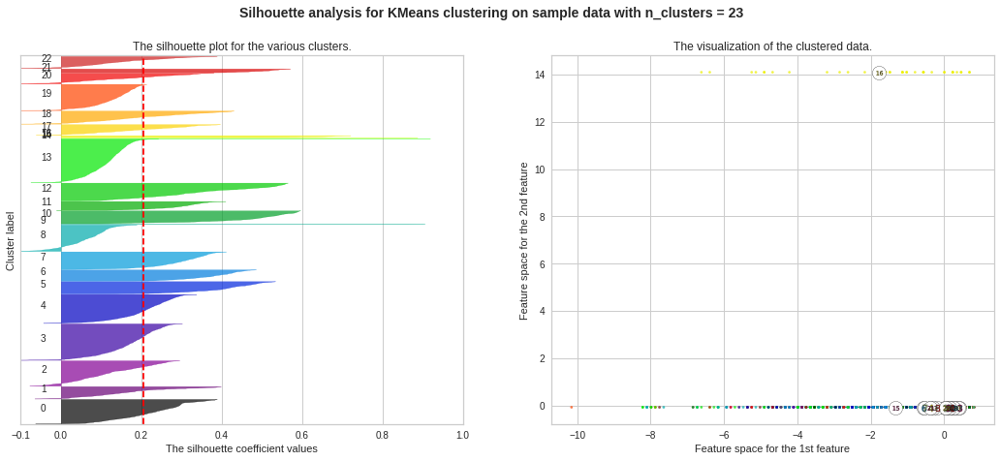

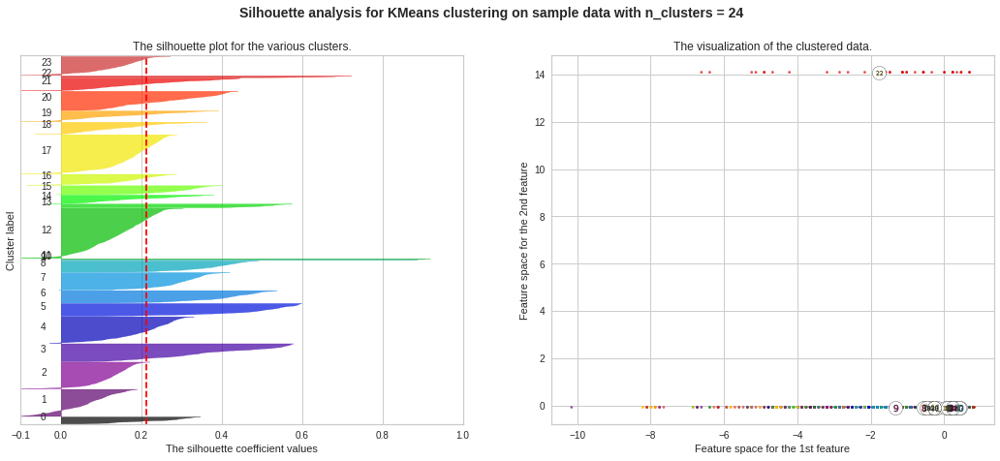

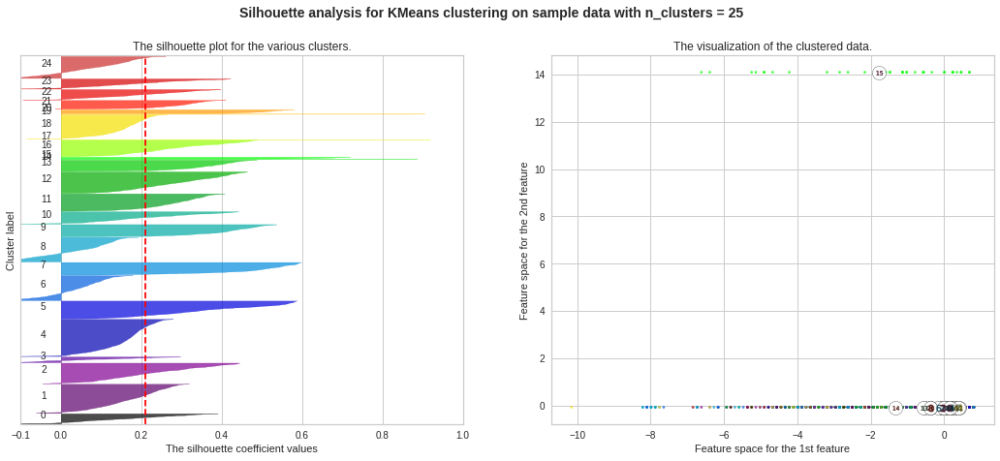

In [339]:
range_n_clusters = [i for i in range(2,26)]
silhouette_score_ = []
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) /n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")
    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

## **Visualisation of K means using PCA**



In [340]:
clusterer = KMeans(n_clusters= 18, n_init=10,random_state=10)
preds = clusterer.fit_predict(X)

In [343]:
predictions = pd.DataFrame(preds, columns = ['Clusters'])

In [344]:
# Dimensionality reduction using PCA
from sklearn.decomposition import PCA
pca = PCA(n_components = 3)


In [345]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
kmeans_cluster = pd.concat([reduced, predictions], axis=1)

In [346]:
gyr = ['#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff']
sns.color_palette(gyr)

[(0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0)]

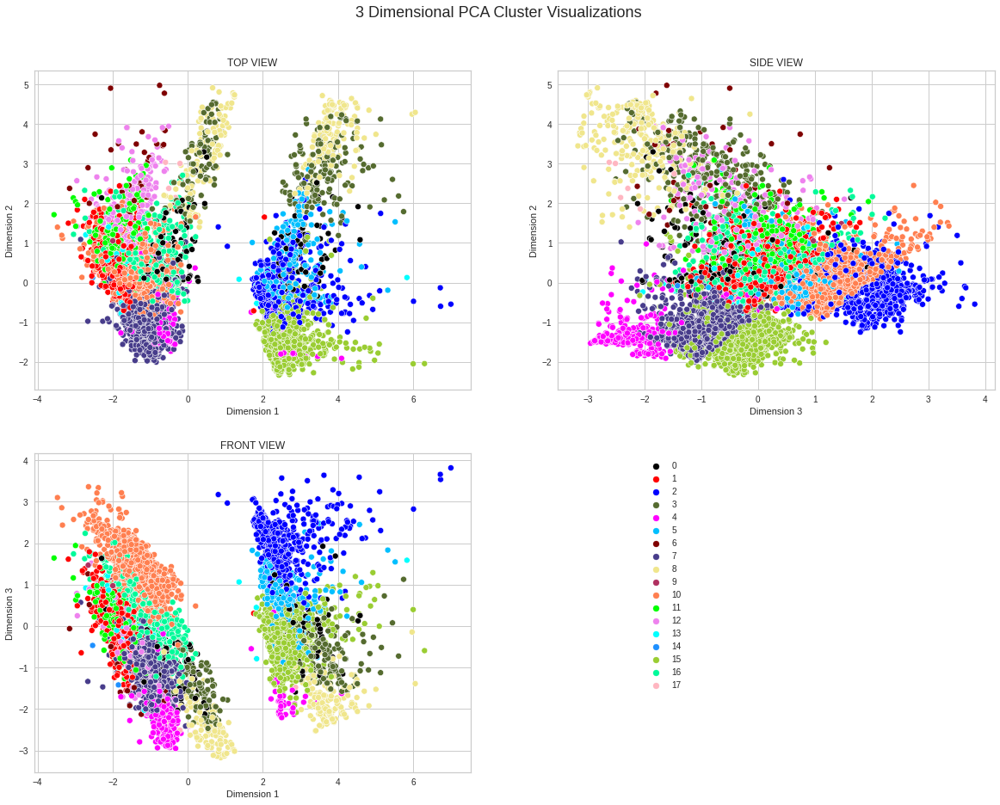

In [347]:
from matplotlib import transforms
plt.figure(figsize=(20,15))
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)

plt.subplot(2,2,1)
plt.title('TOP VIEW')
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr[:18]), legend=False
                )

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr[:18]), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = kmeans_cluster, hue = 'Clusters',palette = sns.color_palette(gyr[:18]))
plt.legend(bbox_to_anchor=(1.5,1))


# **HIERARCHICAL CLUSTERING**

Hierarchical clustering, also known as hierarchical cluster analysis, is an algorithm that groups similar objects into groups called clusters. The endpoint is a set of clusters, where each cluster is distinct from each other cluster, and the objects within each cluster are broadly similar to each other.


In [348]:
# Let's import sch
import scipy.cluster.hierarchy as sch
hier_ward_euc = sch.linkage(X, method = 'ward', metric = 'euclidean')

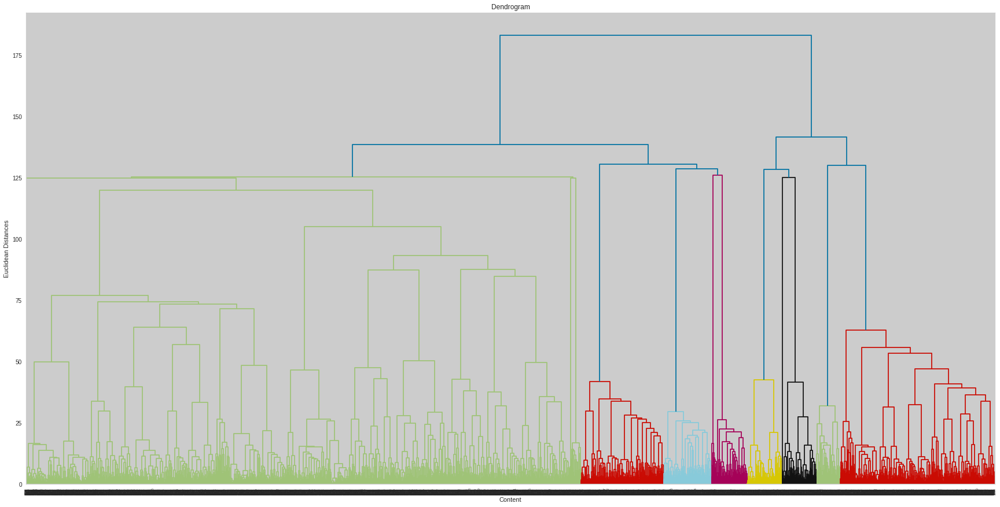

In [356]:
plt.figure(figsize=(30,15))
dendrogram = sch.dendrogram(hier_ward_euc)
plt.title('Dendrogram')
plt.xlabel('Content')
plt.ylabel('Euclidean Distances')
plt.show() # find largest vertical distance we can make without crossing any other horizontal line


###Agglomerative Clustering

In [350]:
clusters = []
scores = []
distances = []
for i in np.arange(10,150,5):
  hc = AgglomerativeClustering(n_clusters = None, distance_threshold = i, affinity = 'euclidean', linkage = 'ward')
  y_hc = hc.fit_predict(X)
  clusters.append(hc.labels_.max()+1)
  if (hc.labels_.max()+1 >=2) :
    scores.append(silhouette_score(X, y_hc))
  else:
    scores.append(1)
  distances.append(i)

hierarchical = pd.DataFrame({'Clusters': clusters, 
                             'Silhouette Scores': scores,
                             'Distance': distances})

**DISTANCE vs SILHOUETTE SCORES GRAPH FOR HIERARCHICAL CLUSTERING**

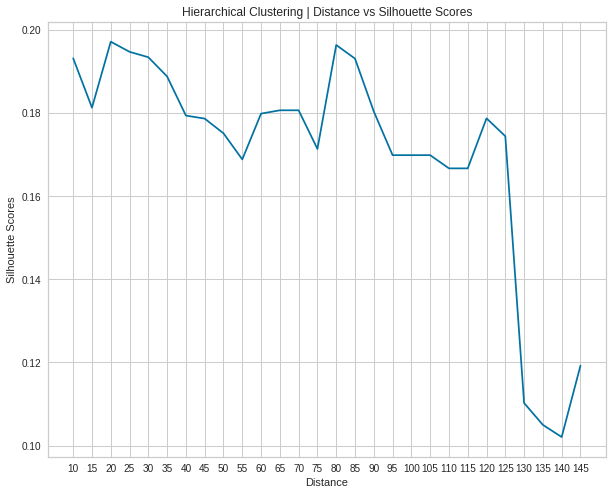

In [353]:
plt.figure(figsize =(10,8))
sns.lineplot(x = 'Distance', y = 'Silhouette Scores' , data = hierarchical)
a = plt.title('Hierarchical Clustering | Distance vs Silhouette Scores')
_ = plt.xticks(np.arange(10,150,5))

**Distance-Silhouette Score-Clusters Table for Hierarchical Clustering**

In [366]:
hierarchical.sort_values('Silhouette Scores', ascending = False).head()

,Clusters,Silhouette Scores,Distance
2,104,0.197192,20
14,19,0.196397,80
3,83,0.194755,25
4,57,0.193451,30
0,318,0.193187,10


#### **OBSERVATIONS**
---
> * **Optimal Distance observed near 80 for Hierarchical Clustering with Silhouette Score of 0.196**
> * **Has 19 Clusters for Optimal Hierarchical Clustering**
---

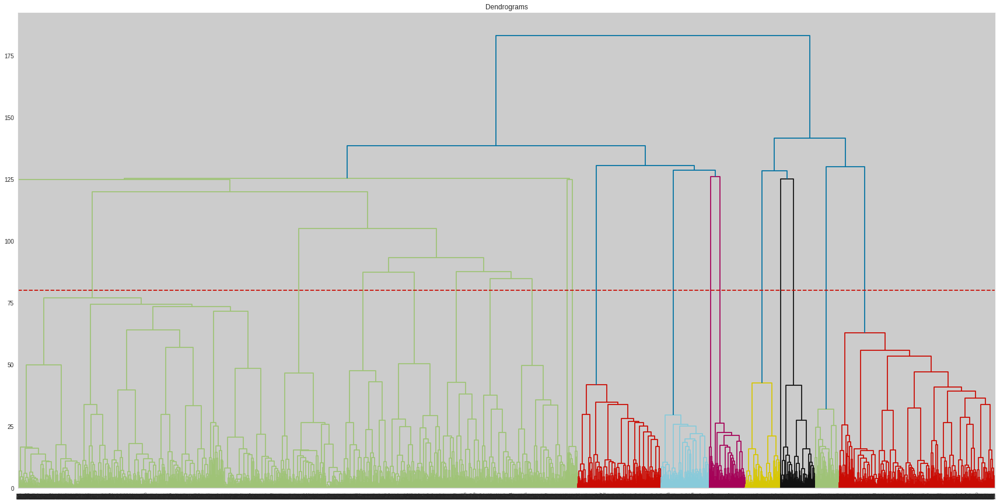

In [355]:
plt.figure(figsize =(30,15))
plt.title("Dendrograms")  
dend = sch.dendrogram(sch.linkage(X, method='ward'))
plt.axhline(y= 80, color='r', linestyle='--')

###**Visualisation of Clusters for Hierarchical Clustering**

In [357]:
hc = AgglomerativeClustering(n_clusters = None, distance_threshold = 80, affinity = 'euclidean', linkage = 'ward')
preds = hc.fit_predict(X)

In [358]:
predictions = pd.DataFrame(preds, columns = ['Labels'])

In [359]:
# Dimensionality reduction using PCA
pca = PCA(n_components = 3)

In [360]:
reduced = pd.DataFrame(pca.fit_transform(X), columns = ['Dimension 1', 'Dimension 2', 'Dimension 3'])
hier_cluster = pd.concat([reduced, predictions], axis=1)

In [361]:
colors = ['#000000','#ff0000','#0000ff','#556b2f','#ff00ff','#00bfff',
 '#7f0000','#483d8b','#f0e68c','#b03060','#ff7f50','#00ff00',
 '#ee82ee','#00ffff','#1e90ff','#9acd32','#00fa9a','#ffb6c1',
 '#8b008b','#b8860b','#00008b','#ffd700','#008000','#008b8b','#e0ffff']


In [362]:
sns.color_palette(colors)

[(0.0, 0.0, 0.0),
 (1.0, 0.0, 0.0),
 (0.0, 0.0, 1.0),
 (0.3333333333333333, 0.4196078431372549, 0.1843137254901961),
 (1.0, 0.0, 1.0),
 (0.0, 0.7490196078431373, 1.0),
 (0.4980392156862745, 0.0, 0.0),
 (0.2823529411764706, 0.23921568627450981, 0.5450980392156862),
 (0.9411764705882353, 0.9019607843137255, 0.5490196078431373),
 (0.6901960784313725, 0.18823529411764706, 0.3764705882352941),
 (1.0, 0.4980392156862745, 0.3137254901960784),
 (0.0, 1.0, 0.0),
 (0.9333333333333333, 0.5098039215686274, 0.9333333333333333),
 (0.0, 1.0, 1.0),
 (0.11764705882352941, 0.5647058823529412, 1.0),
 (0.6039215686274509, 0.803921568627451, 0.19607843137254902),
 (0.0, 0.9803921568627451, 0.6039215686274509),
 (1.0, 0.7137254901960784, 0.7568627450980392),
 (0.5450980392156862, 0.0, 0.5450980392156862),
 (0.7215686274509804, 0.5254901960784314, 0.043137254901960784),
 (0.0, 0.0, 0.5450980392156862),
 (1.0, 0.8431372549019608, 0.0),
 (0.0, 0.5019607843137255, 0.0),
 (0.0, 0.5450980392156862, 0.5450980392156862),
 (0.8784313725490196, 1.0, 1.0)]

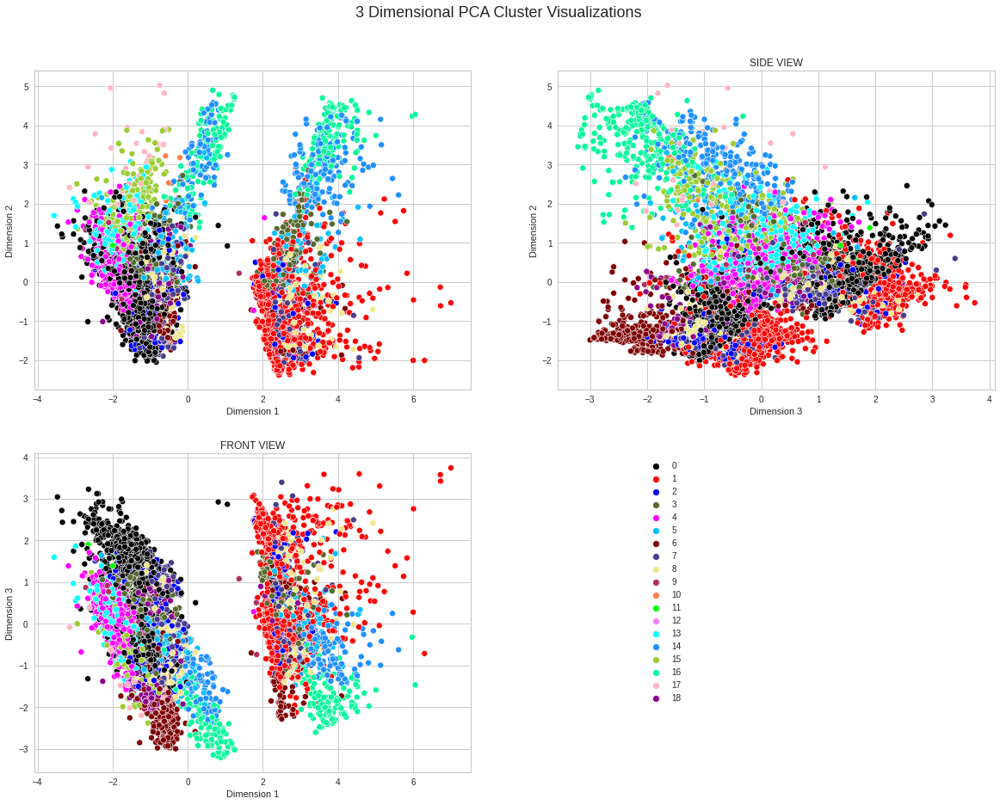

In [364]:
plt.figure(figsize=(20,15))
plt.title('TOP VIEW')
plt.suptitle("3 Dimensional PCA Cluster Visualizations", fontsize=18, y=0.95)
plt.subplot(2,2,1)
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 2', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:19]), legend=False)

plt.subplot(2,2,2)
plt.title('SIDE VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 3', y = 'Dimension 2',  data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:19]), legend=False)

plt.subplot(2,2,3) 
plt.title('FRONT VIEW')
palette = {0: "C0", 1: "C1", 2: "C2", 3: "C3", 4: "C4", 5: "C5",
           6: "C6", 7: "C7", 8: "C8", 9: "C9", 10: "C10", 11: "C11",
           12: "C12", 13: "C13", 14: "C14", 15: "C15", 16: "C16"}
sns.scatterplot(x = 'Dimension 1', y = 'Dimension 3', data = hier_cluster, hue = 'Labels',palette = sns.color_palette(colors[:19]), legend=True)
_ = plt.legend(bbox_to_anchor=(1.5,1))


#CONCLUSIONS